In [1]:
%matplotlib inline
import matplotlib 
import matplotlib.pyplot as plt


In [2]:
import netCDF4 as nc
import numpy as np
import os

In [3]:
# For running from virtual machine
data_dir = "/media/psf/QIceRadar01"
bas_dir = os.path.join(data_dir, "ANTARCTIC", "BAS")

## Data Display

* view radargram in map-view
* plot radargram in 2d
* map from trace to lat/lon
* show surface/bed picks


They also have documentation for how to interact with the netCDF files:
https://antarctica.github.io/PDC_GeophysicsBook/data-portal/Checking_Airborne_Radar_Echo_sounding_data.html

#### One cell per survey; keeping these around to make it easy to look at the documentation for each dataset. 

In [4]:
# 2004; Pine Island Glacier
survey = "BBAS"
filename = "BBAS_T04.nc"
filepath = os.path.join(bas_dir, survey, filename)
ff=nc.Dataset(filepath, 'r')

In [5]:
# 2005; PASIN; Wilkes Subglacial Basin / Dome C / TAM / George V Land / Northern Victoria Land
survey = "WISE_ISODYN"
filename = "WISE_ISODYN_W14.nc"
filepath = os.path.join(bas_dir, survey, filename)
ff=nc.Dataset(filepath, 'r')

In [6]:
# 2006
survey = "GRADES_IMAGE"
filename = "GRADES_IMAGE_G10.nc"
filepath = os.path.join(bas_dir, survey, filename)
ff=nc.Dataset(filepath, 'r')

In [7]:
# 2007-2009; chirp and pulse radargrams are different lengths.
survey = "AGAP"
filename = "AGAP_A44.nc"
filepath = os.path.join(bas_dir, survey, filename)
ff=nc.Dataset(filepath, 'r')

In [8]:
# 2010; Institute/Moller, Patriot Hills. Has two different chirp data systems: chirp_{cHG, DLRsar}_data
survey = "IMAFI"
filename = "IMAFI_C20b.nc"
filepath = os.path.join(bas_dir, survey, filename)
ff=nc.Dataset(filepath, 'r')

In [9]:
# 2012; Recovery / Dronning Maud Land. Only chirp data.
survey = "ICEGRAV"
filename = "ICEGRAV_G12B.nc"
filepath = os.path.join(bas_dir, survey, filename)
ff=nc.Dataset(filepath, 'r')

In [32]:
# 2015; PASIN-2 Pole, Foundation, Recovery. Includes polarized data.
# pulse & chirp data is different lengths, but this time, it's aligned to the chirp data.
# The pulse data is HUGE (~3GB/file); the chirp is more reasonable (~300MB/file). 
survey = "POLARGAP"
filename = "POLARGAP_P21A.nc"
# "    Note that from flight line P24- onwards, there is no polarised data for this survey."
# So, instead of using "polarised_chirp_PPVV_data" (or "polarised_chirp_SSHH_data"), just use "chirp_data"
filename = "POLARGAP_P25A.nc"
filepath = os.path.join(bas_dir, survey, filename)
ff=nc.Dataset(filepath, 'r')


In [11]:
# PASIN-2; 2015
# Using laser for surface detection in radargrams, where possible; otherwise, picked from radargram
# It seems like the Pulse radargram doesn't match the picks -- there's a vertical offset?
survey = "FISS2015"
filename = "FISS2015_FO3A.nc"
filepath = os.path.join(bas_dir, survey, filename)
ff=nc.Dataset(filepath, 'r')

In [12]:
# This season had a bunch of different radar parameters, and some flights didn't have srf/bed picks.
survey = "FISS2016"
filename = "FISS2016_F18A.nc"
filepath = os.path.join(bas_dir, survey, filename)
ff=nc.Dataset(filepath, 'r')

In [5]:
# 2019; PASIN-2
survey = "ITGC_2019"
filename = "ITGC_2019_T04A.nc"
filepath = os.path.join(bas_dir, survey, filename)
ff2=nc.Dataset(filepath, 'r')

In [6]:
ff2.variables['chirp_data'][:].data

/tmp/ipykernel_78259/1027564837.py:1: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  ff2.variables['chirp_data'][:].data


array([[2.73200241e-03, 4.87688649e-03, 5.25735086e-03, ...,
        2.74222484e-03, 2.32217810e-03, 3.21183424e-03],
       [2.61235237e-03, 4.72327974e-03, 5.08708321e-03, ...,
        2.59325677e-03, 2.21478916e-03, 3.07821017e-03],
       [2.49559549e-03, 4.57337731e-03, 4.92563006e-03, ...,
        2.44820933e-03, 2.11118627e-03, 2.95731542e-03],
       ...,
       [4.44231425e-08, 1.07623755e-07, 2.91612508e-07, ...,
        9.11400093e-08, 3.35136860e-07, 1.01819396e-07],
       [4.83459779e-08, 9.25175669e-08, 2.92104659e-07, ...,
        1.04721977e-07, 3.30527428e-07, 1.14943013e-07],
       [5.43201715e-08, 7.75243549e-08, 2.88855887e-07, ...,
        1.16385742e-07, 3.19528255e-07, 1.27108876e-07]], dtype=float32)

In [7]:
ff.variables['chirp_data'].shape

(1250, 27646)

In [13]:
print(ff)

<class 'netCDF4._netCDF4.Dataset'>
root group (NETCDF4 data model, file format HDF5):
    title: Processed airborne radio-echo sounding data from the POLARGAP survey covering the South Pole, and Foundation and Recovery Glaciers, East Antarctica (2015/2016)
    summary: During the austral summer of 2015/16, a major international collaboration funded by the European Space Agency (ESA) and with in-kind contribution from the British Antarctic Survey, 
    the Technical University of Denmark (DTU), the Norwegian Polar Institute (NPI) and the US National Science Foundation (NSF), acquired ~38,000 line km of aerogeophysical data. 

    The primary objective of the POLARGAP campaign was to carry out an airborne gravity survey covering the southern polar gap of the ESA gravity field mission GOCE, 
    beyond the coverage of the GOCE orbit (south of 83.5degS), however aeromagnetics and ice-penetrating radar data were also opportunistically acquired. 
    This survey covers the South Pole and Rec

/tmp/ipykernel_48088/1367651910.py:1: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  print(ff)


In [15]:
ff.campaign

'ITGC 2019/20'

In [16]:
ff.license

'http://www.nationalarchives.gov.uk/doc/open-government-licence/version/3/'

In [17]:
ff.resolution

'Vertical resolution of the system (using velocity in ice of 168.5e6 microseconds): 7.0 m.\n    Analysis of 52 crossover points within the survey area indicates a standard deviation for the bed elevation of ~22m, which is in-line with the values suggested for \n    previous radar surveys. LIDAR-derived surface elevation has a crossover error of ~10 m. The relatively high value is attributed to the use of LIDAR nadir range to ground \n    un-corrected for aircraft roll, pitch and yaw. The line spacing for this survey is ~15 km and trace spacing on post-processed data is ~24 m'

In [18]:
ff.time_coverage_start

'2019-12-24'

In [19]:
ff.ncattrs()

['title',
 'summary',
 'history',
 'keywords',
 'Conventions',
 'standard_name_vocabulary',
 'acknowlegement',
 'institution',
 'license',
 'location',
 'instrument',
 'platform',
 'source',
 'time_coverage_start',
 'time_coverage_end',
 'flight',
 'campaign',
 'project',
 'creator_name',
 'geospatial_lat_min',
 'geospatial_lat_max',
 'geospatial_lon_min',
 'geospatial_lon_max',
 'radar_parameters',
 'antenna',
 'digitiser',
 'processing',
 'resolution',
 'GPS',
 'projection',
 'references',
 'metadata_link',
 'related_datasets',
 'publisher_name',
 'publisher_type',
 'publisher_email',
 'publisher_link',
 'comment']

In [20]:
ff.dimensions

{'traces': <class 'netCDF4._netCDF4.Dimension'>: name = 'traces', size = 8250,
 'fast_time': <class 'netCDF4._netCDF4.Dimension'>: name = 'fast_time', size = 7680}

In [21]:
ff.variables['chirp_data'][:].shape

(7680, 8250)

In [22]:
ff.variables.keys()

dict_keys(['traces', 'fast_time', 'x_coordinates', 'y_coordinates', 'chirp_data', 'pulse_data', 'longitude_layerData', 'latitude_layerData', 'UTC_time_layerData', 'PriNumber_layerData', 'aircraft_altitude_layerData', 'terrainClearanceAircraft_layerData', 'surface_altitude_layerData', 'surface_pick_layerData', 'bed_altitude_layerData', 'bed_pick_layerData', 'land_ice_thickness_layerData'])

In [23]:
ff.variables['fast_time'][:]

masked_array(data=[0.0000000e+00, 8.3344188e-03, 1.6668838e-02, ...,
                   6.3983330e+01, 6.3991665e+01, 6.4000000e+01],
             mask=False,
       fill_value=1e+20,
            dtype=float32)

## Plot radargrams

There is some season-specific weirdness to some of BAS's data.
This notebook has attempted to plot one radargram from each season to check that it all works.

In [15]:
def plot_bas_chirp_radargram(filename, xlim=None, highlighted_traces=None):
    campaign = '_'.join(filename.split('_')[:-1])
    filepath = os.path.join(bas_dir, campaign, filename)
    dd=nc.Dataset(filepath, 'r')

    # NOTE: I'm torn on whether to use campaign vs. data fields to make this decision.
    #    I wound up choosing campaign since the presence of PriNumber isn't a good signal
    #    as to which direction interpolation needs to go: FISS2016 uses them for segy, but
    #    in netCDF pulse/chirp are same length with the traces aligned; AGAP has picks
    #    indexed to traces_pulse, and POLARGAP has picks indexed to traces_chirp.
    #    (I guess I could check based on length...)
    #    However, this means that adding new campaigns may require editing code, even if
    #    they're consistent with a previous campaign's format.
    if dd.campaign == "IMAFI":
        # The IMAFI season had two different versions of the chirp product: cHG, DLRsar
        # For now, arbitrarily picking cHG
        chirp_data = dd.variables['chirp_cHG_data'][:].data
    elif dd.campaign == "POLARGAP":
        # The POLARGAP season had polarised_chirp_{PPVV,SSHH}_data
        try:
            chirp_data = dd.variables['polarised_chirp_PPVV_data'][:].data
        except KeyError:
            chirp_data = dd.variables['chirp_data'][:].data
    else:
        chirp_data = dd.variables['chirp_data'][:].data
   
    # NB: BAS tutorial recommends converting to dB here: chirp = 10*np.log10(chirp)
    # QUESTION: However, the metadata says it's already in dBm?
    chirp_data = np.log10(chirp_data)
    
    # Handle pulse <-> chirp interpolation, if necessary
    # pick_traces should be the variable that matches the {x, y}_coordinates and {srf, bed}_picks arrays
    # As discussed above, I thought about using presence of "traces_chirp" as flag instead of season
    # name, but then I'd have to figure which direction the interpolation went.
    # (FISS2016 has PriNumber_ variables, but doesn't require interpolation here.)
    if dd.campaign == "AGAP":
        # Chirp and Pulse traces do not align; PriNumber_{pulse, chirp} gives effective timestamps on the same "clock" for both.
        # All other data fields are provided for pulse trace numbers, and we need to find the equivalent chirp trace
        # for plotting on the chirp radargram.
        traces_chirp = dd.variables['traces_chirp'][:].data
        traces_pulse = dd.variables['traces_pulse'][:].data
        pri_chirp = dd.variables['PriNumber_chirp'][:].data
        pri_pulse = dd.variables['PriNumber_pulse'][:].data
        # Equivalent chirp trace for each enry in data indexed by pulse traces; no need to round to int because only used for plotting.
        pick_traces = np.interp(pri_pulse, pri_chirp, traces_chirp)
        
        # Equivalent pulse trace for each highlighted trace, needed for positioning
        interpolated_traces = np.interp(pri_chirp[highlighted_traces], pri_pulse, traces_pulse) 
        selected_traces = int(interpolated_traces)
    elif dd.campaign == "POLARGAP":
        # For polargap, chirp/pulse traces don't align, but all ancillary data is indexed to chirp
        pick_traces = dd.variables['traces_chirp'][:].data
        selected_traces = highlighted_traces
    else:        
        pick_traces = dd.variables['traces'][:].data
        selected_traces = highlighted_traces

    xx = dd.variables['x_coordinates'][:].data
    yy = dd.variables['y_coordinates'][:].data
    
    srf_pick = dd.variables['surface_pick_layerData'][:].data 
    fill = dd.variables['surface_pick_layerData']._FillValue  # The example code simply compared to -9999
    srf_pick[srf_pick == fill] = 'nan'  # TODO: Might be nice to show where there aren't picks, rather than relying on absence.
    
    bed_pick = dd.variables['bed_pick_layerData'][:].data
    fill = dd.variables['bed_pick_layerData']._FillValue
    bed_pick[bed_pick == fill] = 'nan'
    
    # surface and bed elevations
    surface_elevation = dd.variables['surface_altitude_layerData'][:].data # read in surface altitude array
    bed_elevation = dd.variables['bed_altitude_layerData'][:].data # read in bed altitude array
    srf_fill = dd.variables['surface_altitude_layerData']._FillValue  # The example code simply compared to -9999
    surface_elevation[surface_elevation == srf_fill] = 'nan' # convert -9999 to NaNs for plotting
    bed_fill = dd.variables['bed_altitude_layerData']._FillValue  # The example code simply compared to -9999
    bed_elevation[bed_elevation == bed_fill] = 'nan' # convert -9999 to NaNs for plotting

    fig = plt.figure(figsize=(20, 12))
    ax1, ax2, ax3 = fig.subplots(1, 3)

    ax1.imshow(chirp_data, cmap='Greys', aspect='auto')
    ax1.set_title("Chirp radargram")
    
    ax2.imshow(chirp_data, cmap='Greys', aspect='auto')
    ax2.set_title(filename)
    ax2.plot(pick_traces, srf_pick,'r.', markersize=0.3) # plot surface pick
    ax2.plot(pick_traces, bed_pick, 'b.', markersize=0.3) # plot bed pick 
    
    ax3.plot(xx, yy, 'k.', markersize=2)
    ax3.set_title("Segment track")
    ax3.set_xlabel("Easting (m)")
    ax3.set_ylabel("Northing (m)")
    
    if xlim is not None:
        ax1.set_xlim(xlim)
        ax2.set_xlim(xlim)
    
    if highlighted_traces is not None:
        num_samples, _ = chirp_data.shape
        ax2.vlines(highlighted_traces, 0, num_samples, color='c')
        ax2.set_ylim([num_samples, 0])
        ax3.plot(xx[selected_traces], yy[selected_traces], 'co', fillstyle='none', markersize=10)

In [25]:
# TODO: It would be good to only load the data once when flipping between different products on the same line.
def plot_bas_pulse_radargram(filename, xlim=None, highlighted_traces=None):
    campaign = '_'.join(filename.split('_')[:-1])
    filepath = os.path.join(bas_dir, campaign, filename)
    dd=nc.Dataset(filepath, 'r')
    
    if dd.campaign == "ICEGRAV":
        print("ICEGRAV doesn't have pulse radargram data.")
        return
    elif dd.campaign == "POLARGAP":
        pulse_data = dd.variables['polarised_pulse_SPHV_data'][:].data
    else:
        pulse_data = dd.variables['pulse_data'][:].data
    
    # NB: BAS tutorial recommends converting to dB here: chirp = 10*np.log10(chirp)
    # QUESTION: However, the metadata says it's already in dBm?
    pulse_data = np.log10(pulse_data)

    # pick_traces should be the variable that matches the {x, y}_coordinates and {srf, bed}_picks arrays.
    if dd.campaign == "AGAP":
        # Chirp and Pulse traces do not align; PriNumber_{pulse, chirp} gives effective timestamps on the same "clock" for both.
        # All other data fields are provided for pulse trace numbers
        pick_traces = dd.variables['traces_pulse'][:].data
        selected_traces = highlighted_traces
    elif dd.campaign == "POLARGAP":
        traces_chirp = dd.variables['traces_chirp'][:].data
        traces_pulse = dd.variables['traces_pulse'][:].data
        pri_chirp = dd.variables['PriNumber_chirp'][:].data
        pri_pulse = dd.variables['PriNumber_pulse'][:].data
        # Equivalent pulse trace for each enry in data indexed by chirp traces; no need to round to int because only used for plotting.
        pick_traces = np.interp(pri_chirp, pri_pulse, traces_pulse) 

        # Equivalent chirp trace for each highlighted trace, needed for positioning
        if highlighted_traces is not None:
            interpolated_traces = np.interp(pri_pulse[highlighted_traces], pri_chirp, traces_chirp) 
            selected_traces = int(interpolated_traces)
        else:
            selected_traces = None
    else:        
        pick_traces = dd.variables['traces'][:].data
        selected_traces = highlighted_traces

    xx = dd.variables['x_coordinates'][:].data
    yy = dd.variables['y_coordinates'][:].data
    
    srf_pick = dd.variables['surface_pick_layerData'][:].data 
    fill = dd.variables['surface_pick_layerData']._FillValue  # The example code simply compared to -9999
    srf_pick[srf_pick == fill] = 'nan'  # TODO: Might be nice to show where there aren't picks, rather than relying on absence.
    
    bed_pick = dd.variables['bed_pick_layerData'][:].data
    fill = dd.variables['bed_pick_layerData']._FillValue
    bed_pick[bed_pick == fill] = 'nan'
    
    # surface and bed elevations
    surface_elevation = dd.variables['surface_altitude_layerData'][:].data # read in surface altitude array
    bed_elevation = dd.variables['bed_altitude_layerData'][:].data # read in bed altitude array
    srf_fill = dd.variables['surface_altitude_layerData']._FillValue  # The example code simply compared to -9999
    surface_elevation[surface_elevation == srf_fill] = 'nan' # convert -9999 to NaNs for plotting
    bed_fill = dd.variables['bed_altitude_layerData']._FillValue  # The example code simply compared to -9999
    bed_elevation[bed_elevation == bed_fill] = 'nan' # convert -9999 to NaNs for plotting

    fig = plt.figure(figsize=(20, 12))
    ax1, ax2, ax3 = fig.subplots(1, 3)
    
    ax1.imshow(pulse_data, cmap='Greys', aspect='auto')
    ax1.set_title("Pulse radargram")

    ax2.imshow(pulse_data, cmap='Greys', aspect='auto')
    ax2.set_title(filename)
    ax2.plot(pick_traces, srf_pick,'r.', markersize=0.3) # plot surface pick
    ax2.plot(pick_traces, bed_pick, 'b.', markersize=0.3) # plot bed pick 
    
    ax3.plot(xx, yy, 'k.', markersize=2)
    ax3.set_title("Segment track")
    ax3.set_xlabel("Easting (m)")
    ax3.set_ylabel("Northing (m)")
    
    if xlim is not None:
        ax1.set_xlim(xlim)
        ax2.set_xlim(xlim)
    
    if highlighted_traces is not None:
        num_samples, _ = pulse_data.shape
        ax2.vlines(highlighted_traces, 0, num_samples, color='c')
        ax2.set_ylim([num_samples, 0])
        ax3.plot(xx[selected_traces], yy[selected_traces], 'r*', fillstyle='none', markersize=10)

In [36]:
plot_bas_chirp_radargram("WISE_ISODYN_W14.nc", [8000, 12000], [11000])
plot_bas_pulse_radargram("WISE_ISODYN_W14.nc", [8000, 12000], [11000])

/tmp/ipykernel_48088/3235298570.py:14: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  if dd.campaign == "IMAFI":
/tmp/ipykernel_48088/3235298570.py:18: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  elif dd.campaign == "POLARGAP":
/tmp/ipykernel_48088/3235298570.py:25: FutureWarning: In the future `np.bool` will be defined as the corresponding NumPy scalar.
  chirp_data = dd.variables['chirp_data'][:].data


AttributeError: module 'numpy' has no attribute 'bool'.
`np.bool` was a deprecated alias for the builtin `bool`. To avoid this error in existing code, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
The aliases was originally deprecated in NumPy 1.20; for more details and guidance see the original release note at:
    https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations

In [16]:
plot_bas_chirp_radargram("POLARGAP_P25A.nc", [2500, 5000], 4000)
plot_bas_pulse_radargram("POLARGAP_P21A.nc", [25000, 40000], 30000)

/tmp/ipykernel_48088/3235298570.py:14: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  if dd.campaign == "IMAFI":
/tmp/ipykernel_48088/3235298570.py:18: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  elif dd.campaign == "POLARGAP":
/tmp/ipykernel_48088/3235298570.py:23: FutureWarning: In the future `np.bool` will be defined as the corresponding NumPy scalar.
  chirp_data = dd.variables['chirp_data'][:].data


AttributeError: module 'numpy' has no attribute 'bool'.
`np.bool` was a deprecated alias for the builtin `bool`. To avoid this error in existing code, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
The aliases was originally deprecated in NumPy 1.20; for more details and guidance see the original release note at:
    https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations

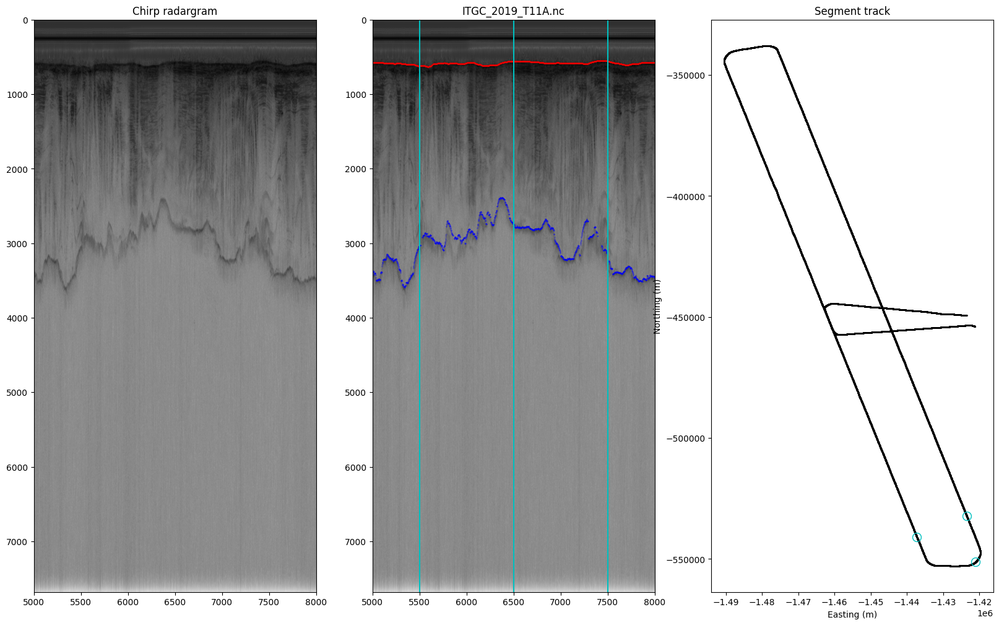

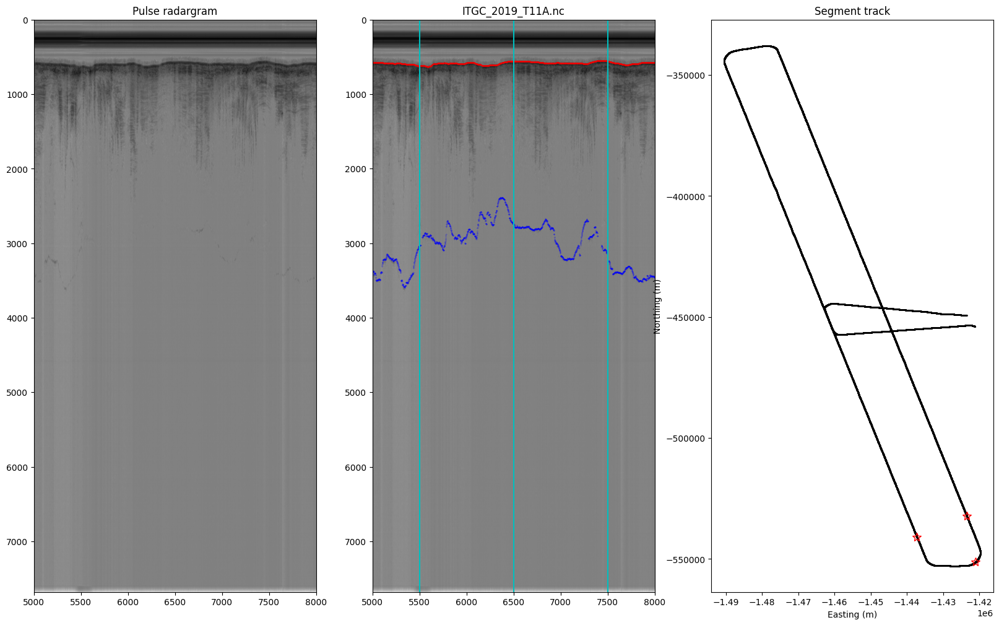

In [29]:
plot_bas_chirp_radargram("ITGC_2019_T11A.nc", [5000, 8000], [5500, 6500, 7500])
plot_bas_pulse_radargram("ITGC_2019_T11A.nc", [5000, 8000], [5500, 6500, 7500])

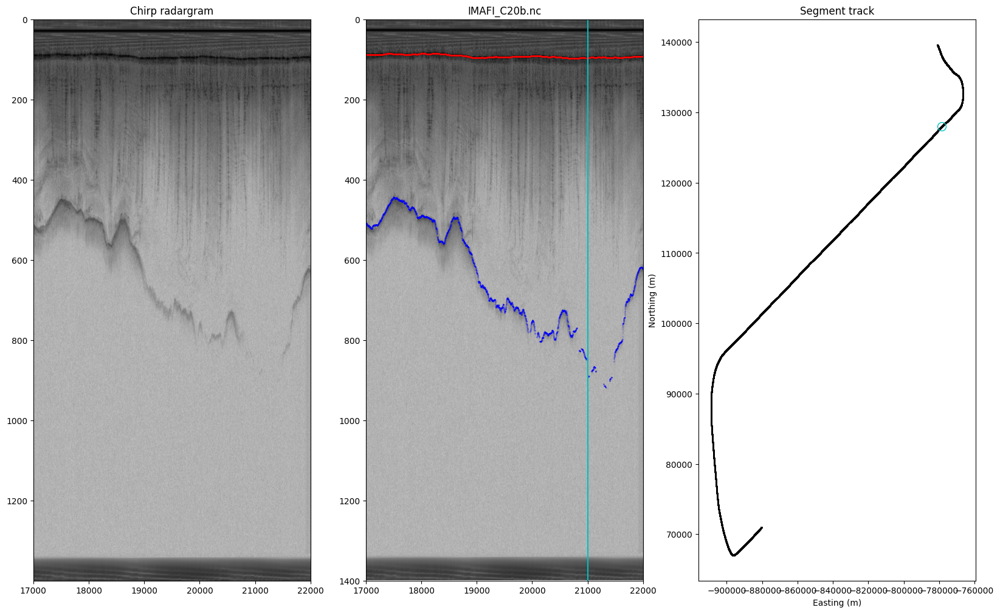

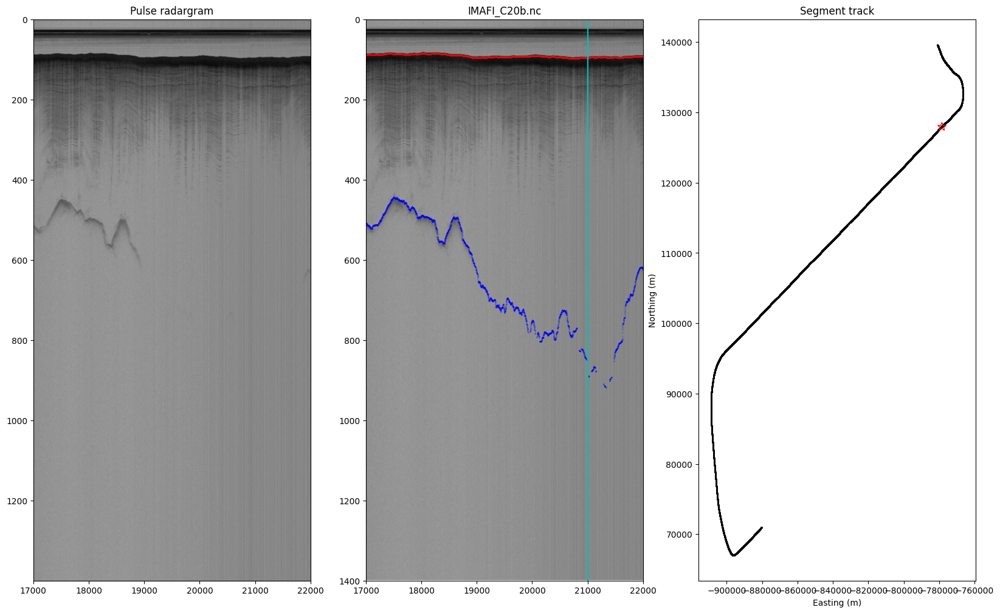

In [30]:
plot_bas_chirp_radargram("IMAFI_C20b.nc", [17000, 22000], 21000)
plot_bas_pulse_radargram("IMAFI_C20b.nc", [17000, 22000], 21000)

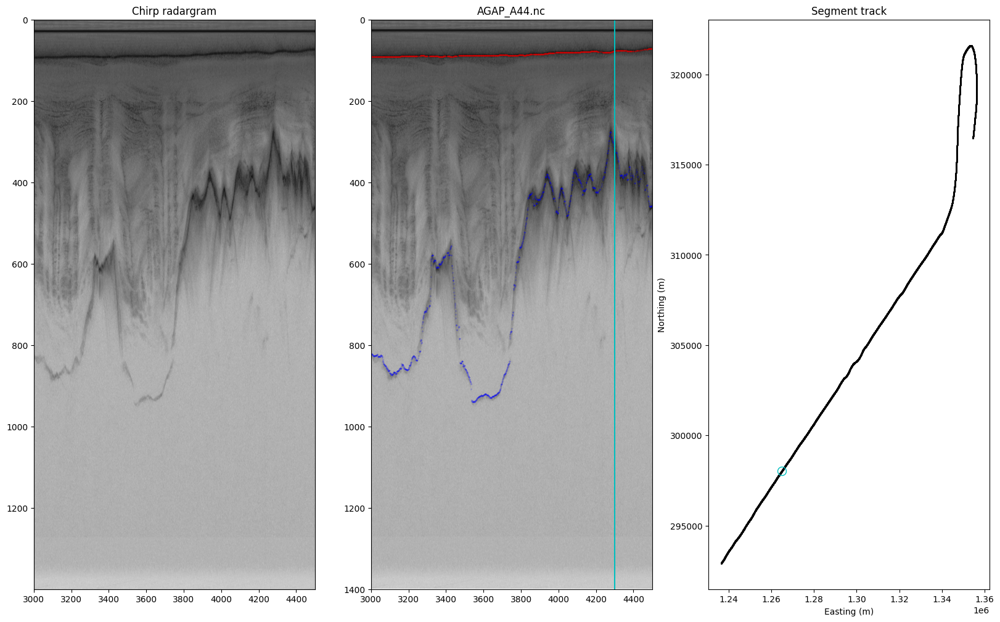

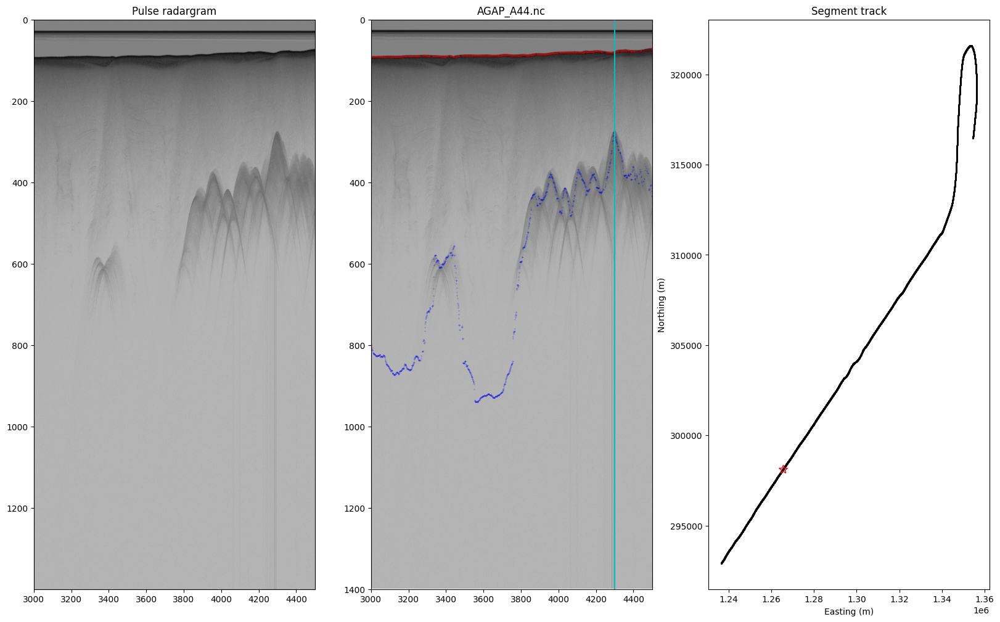

In [31]:
plot_bas_chirp_radargram("AGAP_A44.nc", [3000, 4500], [4300])
plot_bas_pulse_radargram("AGAP_A44.nc", [3000, 4500], [4300])

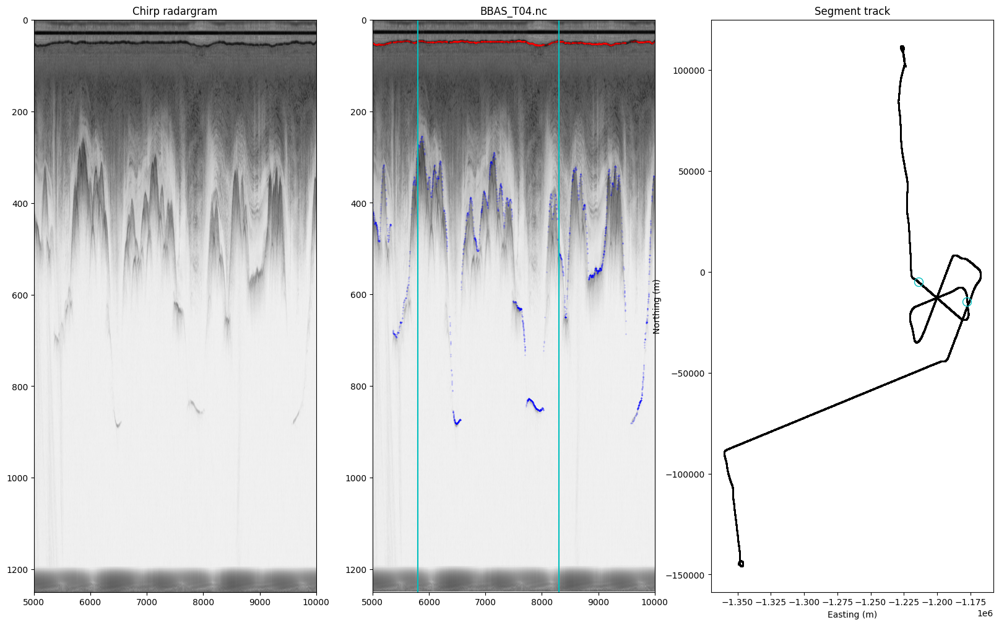

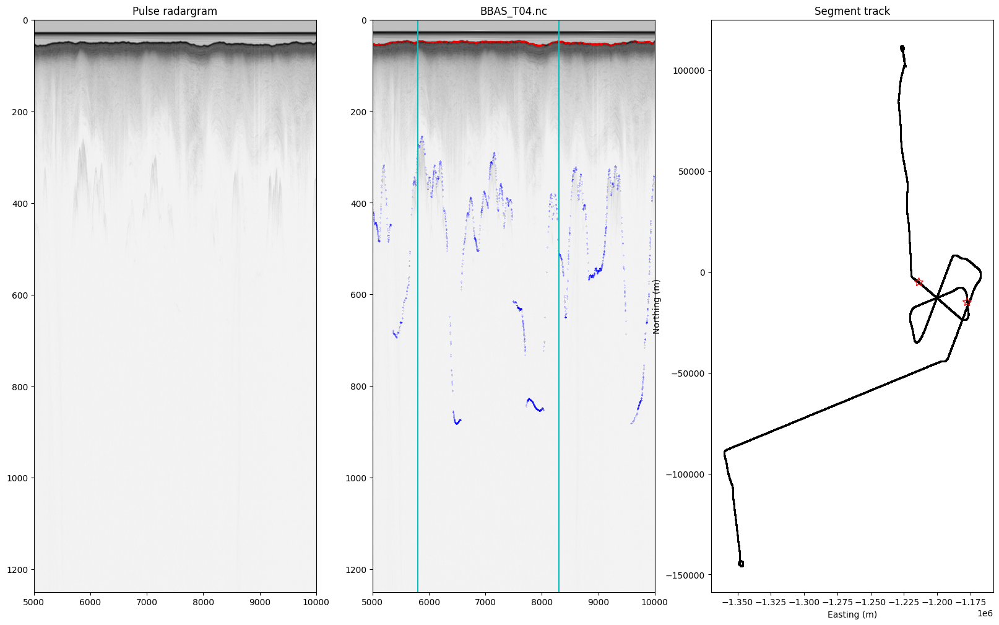

In [32]:
plot_bas_chirp_radargram("BBAS_T04.nc", [5000, 10000], [5800, 8300])
plot_bas_pulse_radargram("BBAS_T04.nc", [5000, 10000], [5800, 8300])

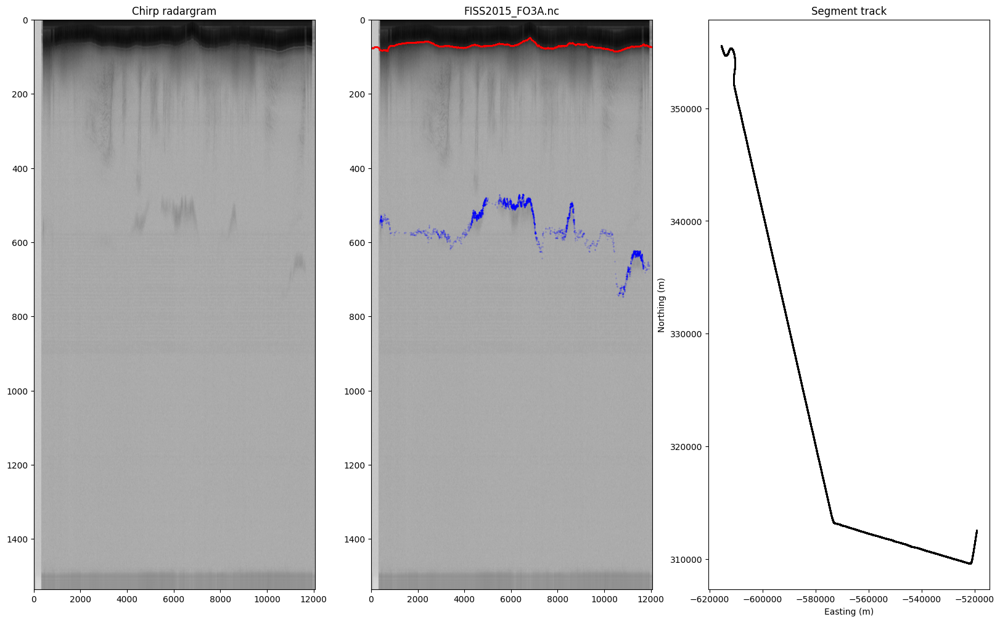

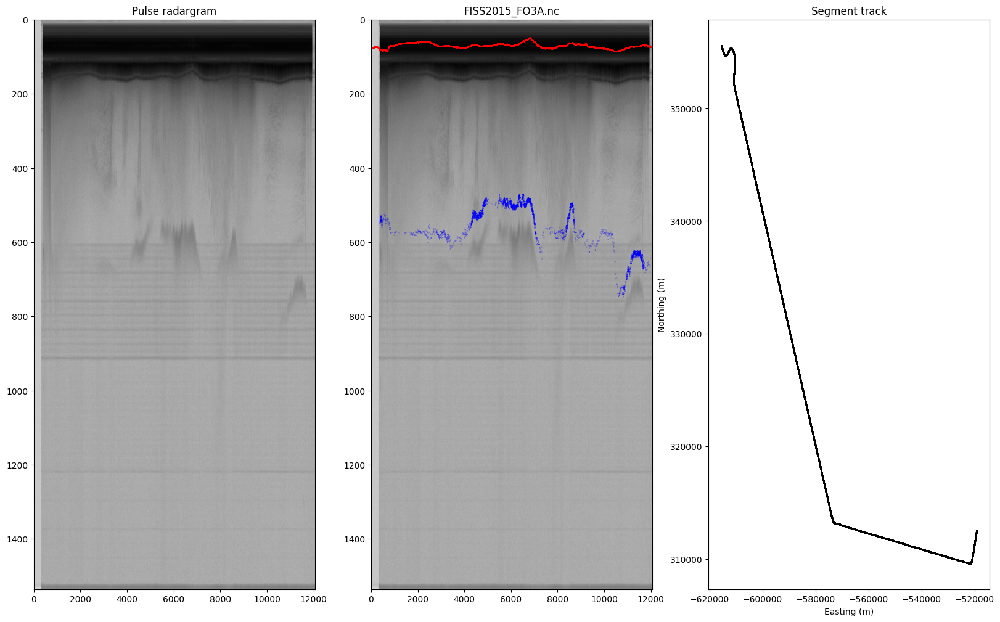

In [33]:
# WOW. This is ugly, and the surface doesn't matchup in the Pulse radargram.
plot_bas_chirp_radargram("FISS2015_FO3A.nc")
plot_bas_pulse_radargram("FISS2015_FO3A.nc")

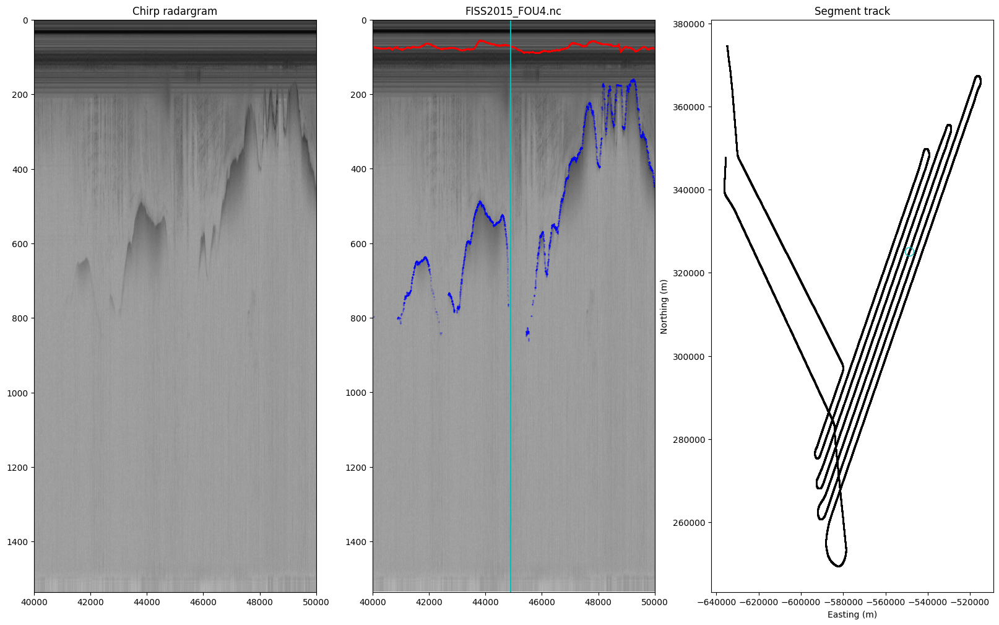

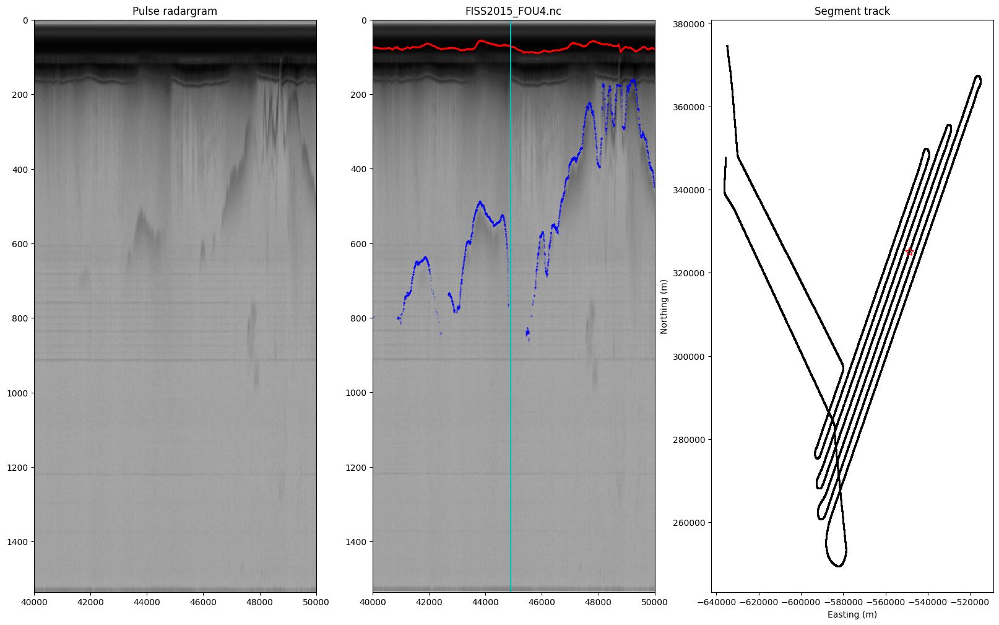

In [34]:
plot_bas_chirp_radargram("FISS2015_FOU4.nc", [40000, 50000], [44900])
plot_bas_pulse_radargram("FISS2015_FOU4.nc", [40000, 50000], [44900])

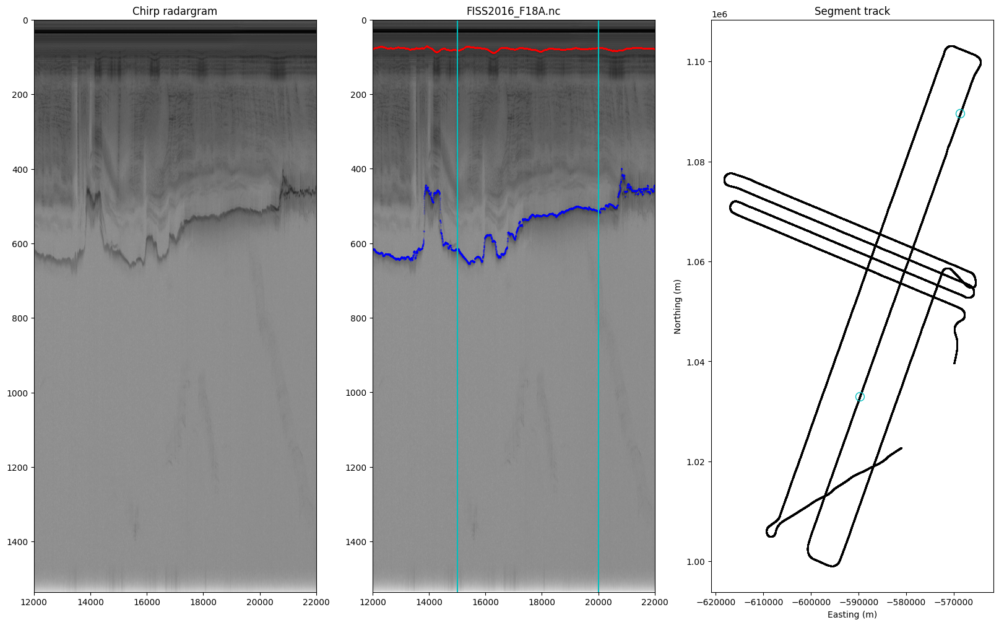

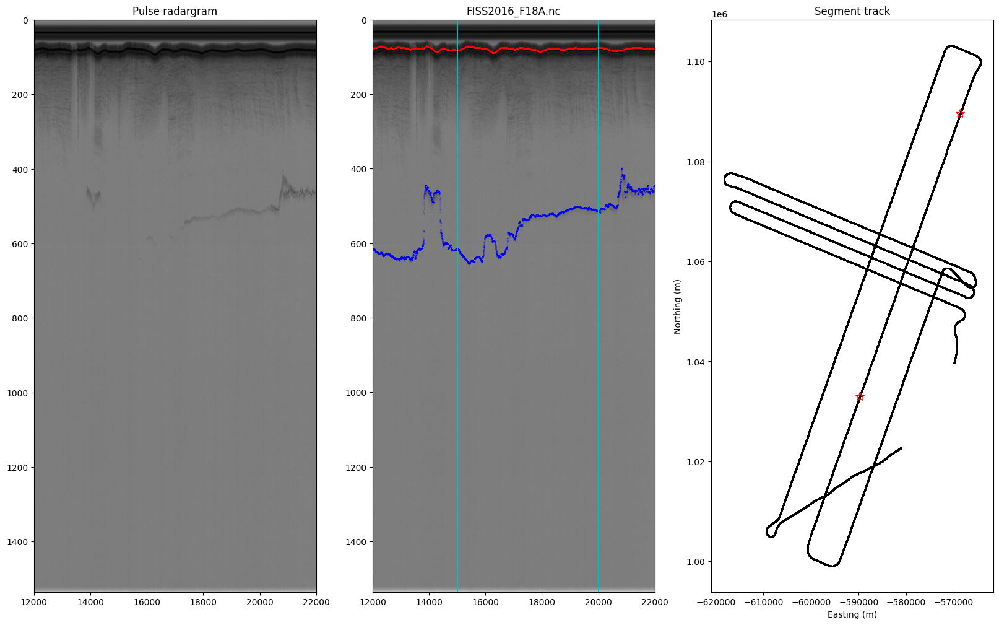

In [35]:
plot_bas_chirp_radargram("FISS2016_F18A.nc", [12000, 22000], [15000, 20000])
plot_bas_pulse_radargram("FISS2016_F18A.nc", [12000, 22000], [15000, 20000])


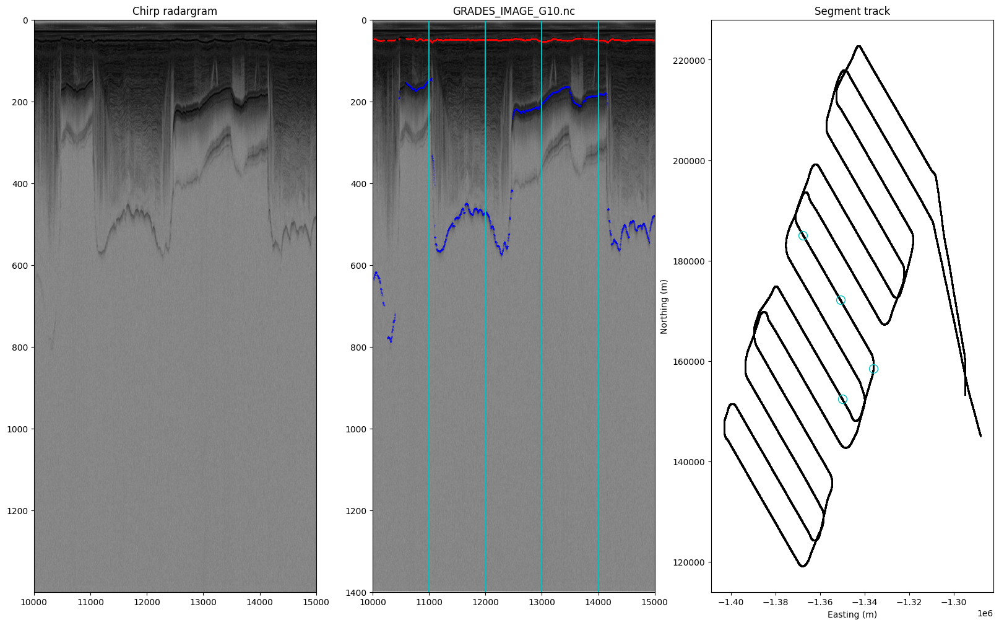

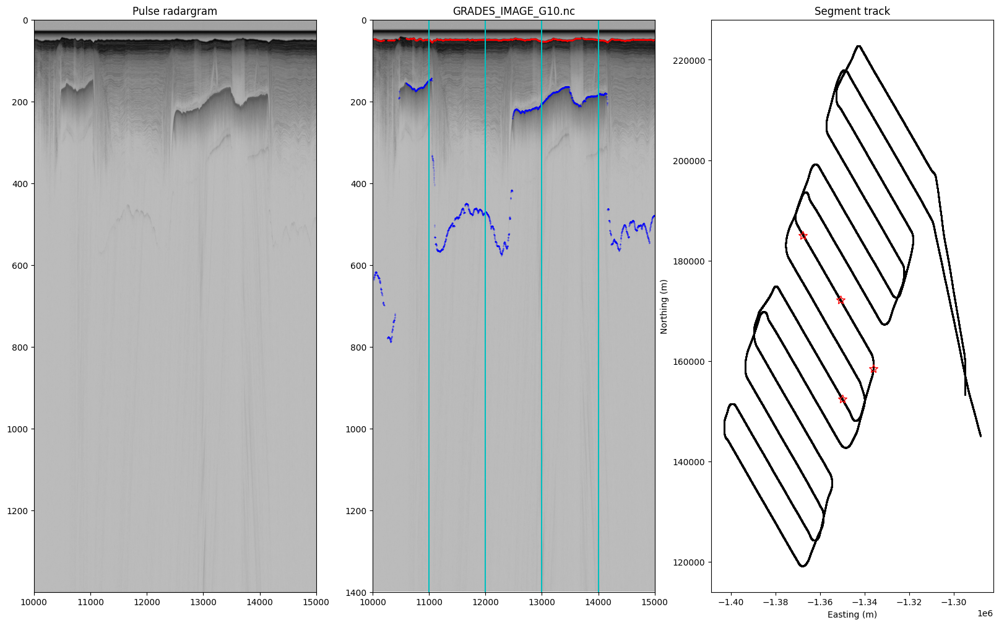

In [36]:
plot_bas_chirp_radargram("GRADES_IMAGE_G10.nc", [10000, 15000], [11000, 12000, 13000, 14000])
plot_bas_pulse_radargram("GRADES_IMAGE_G10.nc", [10000, 15000], [11000, 12000, 13000, 14000])

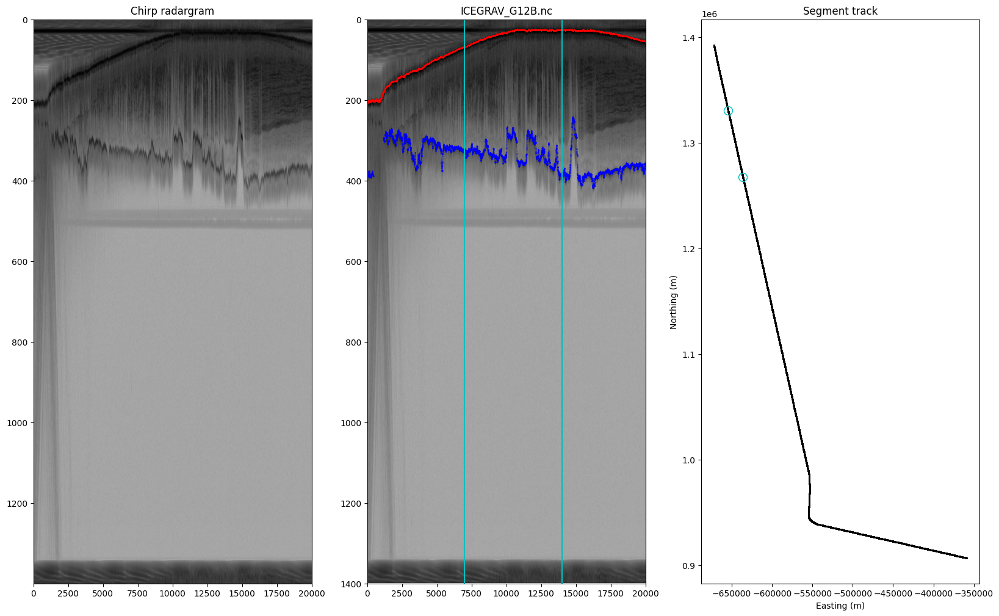

In [37]:
plot_bas_chirp_radargram("ICEGRAV_G12B.nc", [0, 20000], [7000, 14000])
# ICEGRAV is only Chirp data
#plot_bas_pulse_radargram("ICEGRAV", "ICEGRAV_G12B.nc")

## Look for interesting AGAP data

In [38]:
transects = [ff for ff in os.listdir(os.path.join(bas_dir, "AGAP"))
             if ff.endswith('nc') and not ff.startswith('.')]
transects.sort()
print("We have {} transects".format(len(transects)))
print(transects)

We have 87 transects
['AGAP_A03.nc', 'AGAP_A04.nc', 'AGAP_A05.nc', 'AGAP_A05A.nc', 'AGAP_A06C.nc', 'AGAP_A07B.nc', 'AGAP_A07C.nc', 'AGAP_A08.nc', 'AGAP_A09A.nc', 'AGAP_A10B.nc', 'AGAP_A11A.nc', 'AGAP_A12.nc', 'AGAP_A13A.nc', 'AGAP_A13B.nc', 'AGAP_A14.nc', 'AGAP_A14A.nc', 'AGAP_A14B.nc', 'AGAP_A15.nc', 'AGAP_A16.nc', 'AGAP_A17.nc', 'AGAP_A18B.nc', 'AGAP_A19.nc', 'AGAP_A20.nc', 'AGAP_A21B.nc', 'AGAP_A22.nc', 'AGAP_A23.nc', 'AGAP_A24.nc', 'AGAP_A25B.nc', 'AGAP_A26.nc', 'AGAP_A26B.nc', 'AGAP_A27B.nc', 'AGAP_A28.nc', 'AGAP_A29C.nc', 'AGAP_A29D.nc', 'AGAP_A29E.nc', 'AGAP_A29G.nc', 'AGAP_A29H.nc', 'AGAP_A30A.nc', 'AGAP_A31C.nc', 'AGAP_A32.nc', 'AGAP_A33.nc', 'AGAP_A34B.nc', 'AGAP_A35.nc', 'AGAP_A36.nc', 'AGAP_A37.nc', 'AGAP_A38B.nc', 'AGAP_A39D.nc', 'AGAP_A40B.nc', 'AGAP_A40C.nc', 'AGAP_A41.nc', 'AGAP_A42B.nc', 'AGAP_A43B.nc', 'AGAP_A44.nc', 'AGAP_A44B.nc', 'AGAP_A45.nc', 'AGAP_A46B.nc', 'AGAP_A47D.nc', 'AGAP_A48A.nc', 'AGAP_A49.nc', 'AGAP_A50C.nc', 'AGAP_A51C.nc', 'AGAP_A52.nc', 'AGAP_A53A.n

In [39]:
def plot_picked_chirp_radargram(filename, xlim=None, highlighted_traces=None):
    campaign = '_'.join(filename.split('_')[:-1])
    filepath = os.path.join(bas_dir, campaign, filename)
    dd=nc.Dataset(filepath, 'r')
    
    if dd.campaign == "IMAFI":
        chirp_data = dd.variables['chirp_cHG_data'][:].data
    elif dd.campaign == "POLARGAP":
        chirp_data = dd.variables['polarised_chirp_PPVV_data'][:].data
    else:
        chirp_data = dd.variables['chirp_data'][:].data
   
    chirp_data = np.log10(chirp_data)
    
    if dd.campaign == "AGAP":
        traces_chirp = dd.variables['traces_chirp'][:].data
        traces_pulse = dd.variables['traces_pulse'][:].data
        pri_chirp = dd.variables['PriNumber_chirp'][:].data
        pri_pulse = dd.variables['PriNumber_pulse'][:].data
        pick_traces = np.interp(pri_pulse, pri_chirp, traces_chirp)
        if highlighted_traces is not None:
            interpolated_traces = np.interp(pri_chirp[highlighted_traces], pri_pulse, traces_pulse) 
            selected_traces = int(interpolated_traces)
        else:
            selected_traces = None
    elif dd.campaign == "POLARGAP":
        pick_traces = dd.variables['traces_chirp'][:].data
        selected_traces = highlighted_traces
    else:        
        pick_traces = dd.variables['traces'][:].data
        selected_traces = highlighted_traces

    xx = dd.variables['x_coordinates'][:].data
    yy = dd.variables['y_coordinates'][:].data
    
    srf_pick = dd.variables['surface_pick_layerData'][:].data 
    fill = dd.variables['surface_pick_layerData']._FillValue  # The example code simply compared to -9999
    srf_pick[srf_pick == fill] = 'nan'  # TODO: Might be nice to show where there aren't picks, rather than relying on absence.
    
    bed_pick = dd.variables['bed_pick_layerData'][:].data
    fill = dd.variables['bed_pick_layerData']._FillValue
    bed_pick[bed_pick == fill] = 'nan'
    
    # surface and bed elevations
    surface_elevation = dd.variables['surface_altitude_layerData'][:].data # read in surface altitude array
    bed_elevation = dd.variables['bed_altitude_layerData'][:].data # read in bed altitude array
    srf_fill = dd.variables['surface_altitude_layerData']._FillValue  # The example code simply compared to -9999
    surface_elevation[surface_elevation == srf_fill] = 'nan' # convert -9999 to NaNs for plotting
    bed_fill = dd.variables['bed_altitude_layerData']._FillValue  # The example code simply compared to -9999
    bed_elevation[bed_elevation == bed_fill] = 'nan' # convert -9999 to NaNs for plotting

    fig = plt.figure(figsize=(20, 12))
    ax1 = fig.subplots(1, 1)

    ax1.imshow(chirp_data, cmap='Greys', aspect='auto')
    ax1.set_title(filename)
    ax1.plot(pick_traces, srf_pick,'r.', markersize=1.0) # plot surface pick
    ax1.plot(pick_traces, bed_pick, 'r.', markersize=1.0) # plot bed pick 
    
    if xlim is not None:
        ax1.set_xlim(xlim)
    
    if highlighted_traces is not None:
        num_samples, _ = chirp_data.shape
        ax1.vlines(highlighted_traces, 0, num_samples, color='c')
        ax1.set_ylim([num_samples, 0])


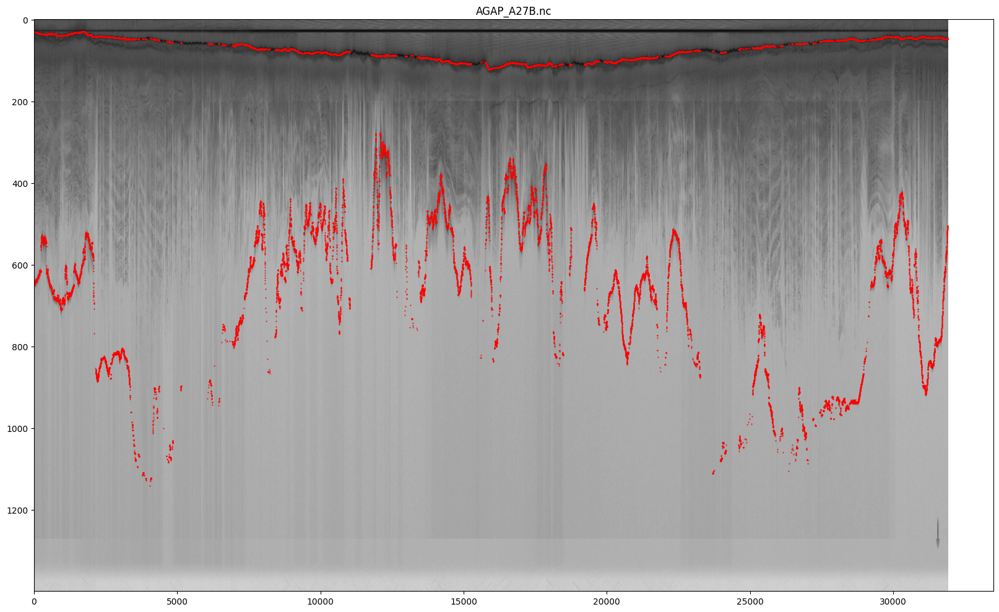

In [40]:
plot_picked_chirp_radargram('AGAP_A27B.nc', xlim=None, highlighted_traces=None)

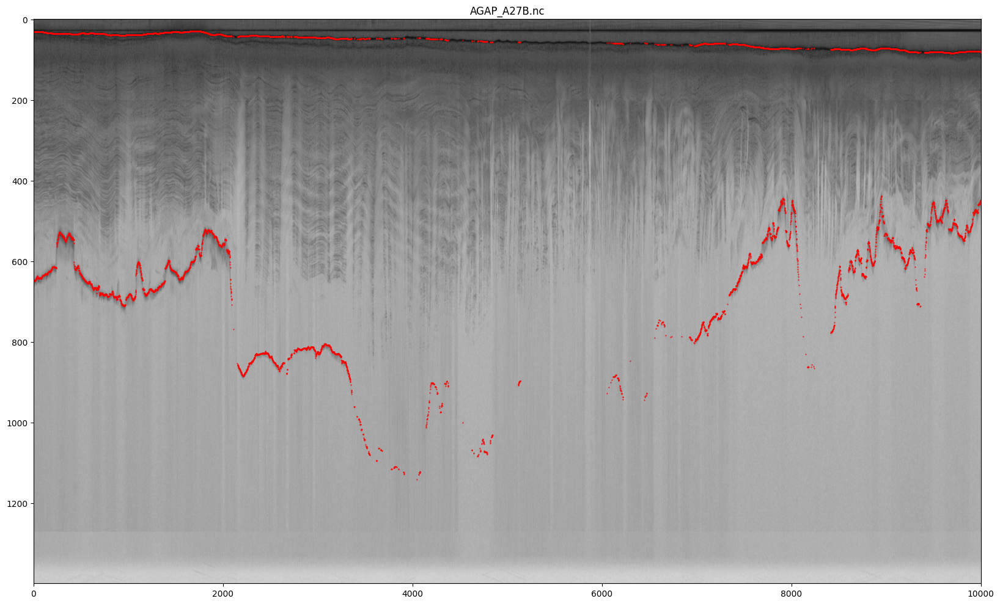

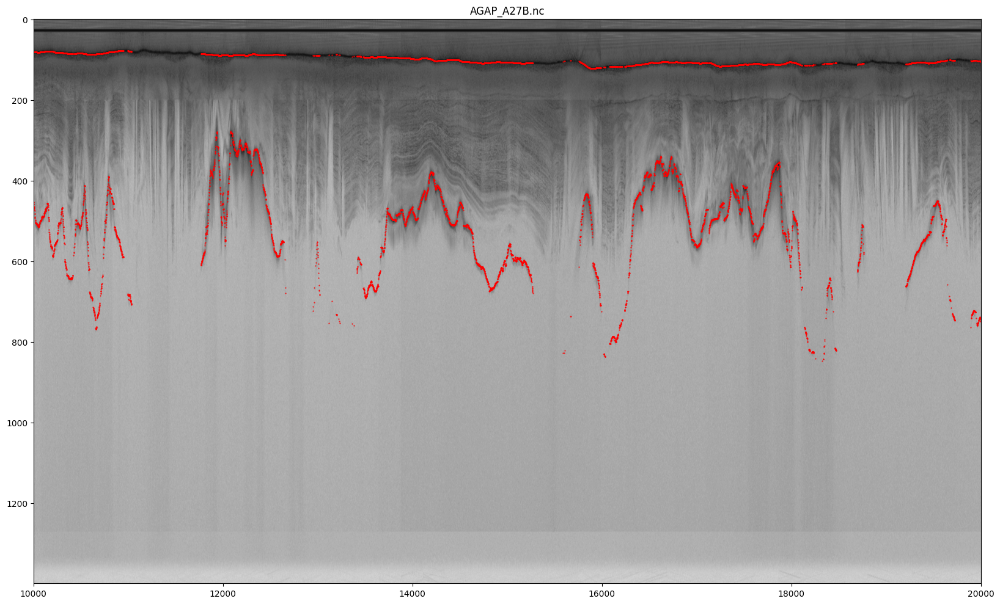

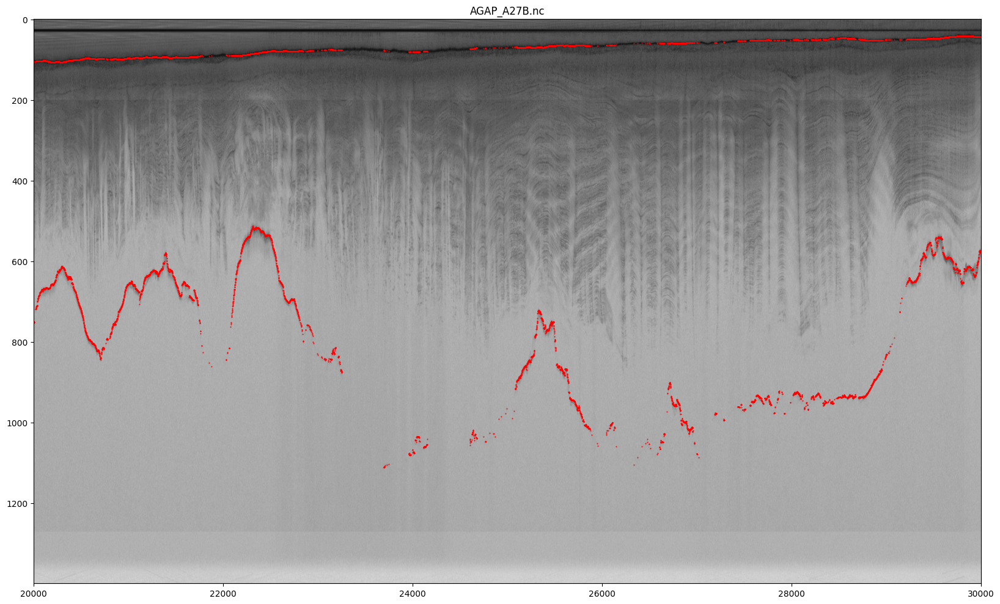

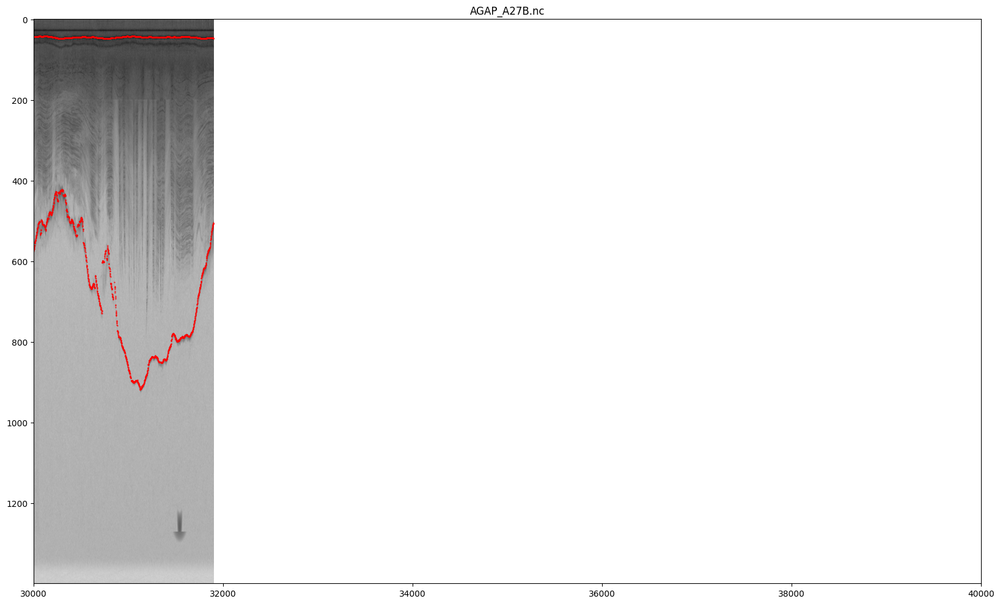

In [41]:
for xlim in [(0, 10000), (10000, 20000), (20000, 30000), (30000, 40000)]:
    plot_picked_chirp_radargram('AGAP_A27B.nc', xlim=xlim, highlighted_traces=None)

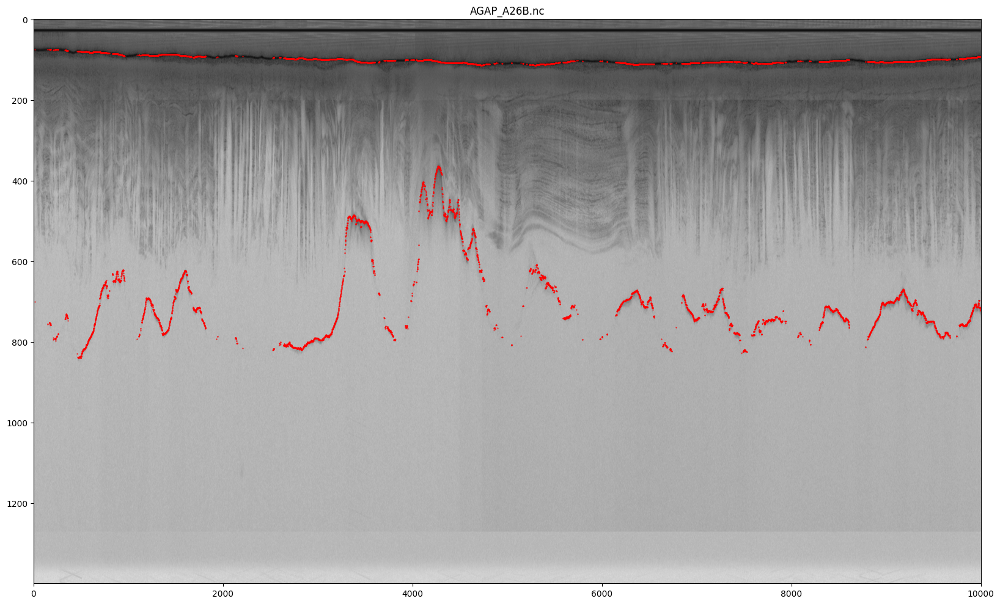

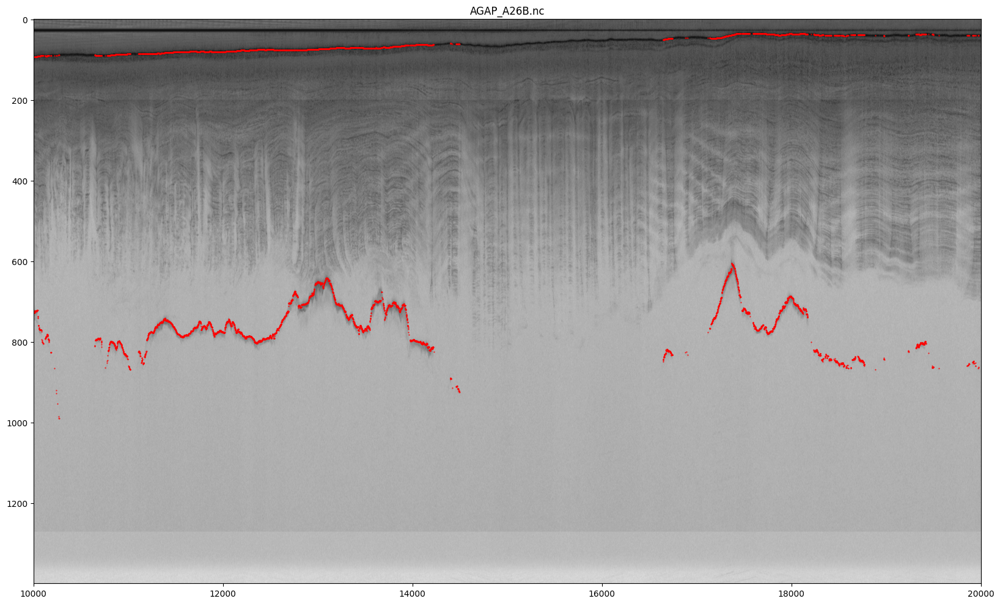

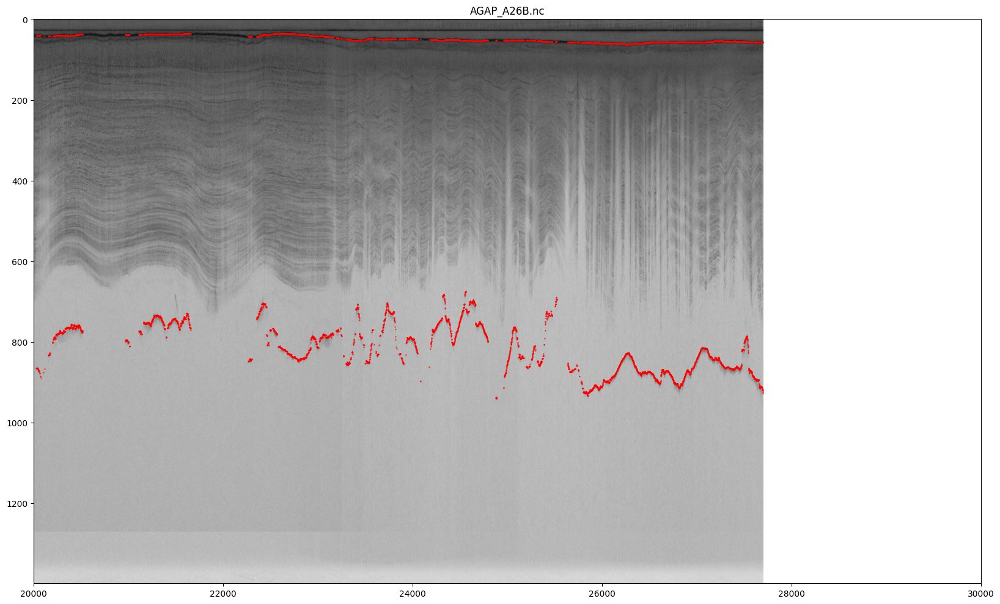

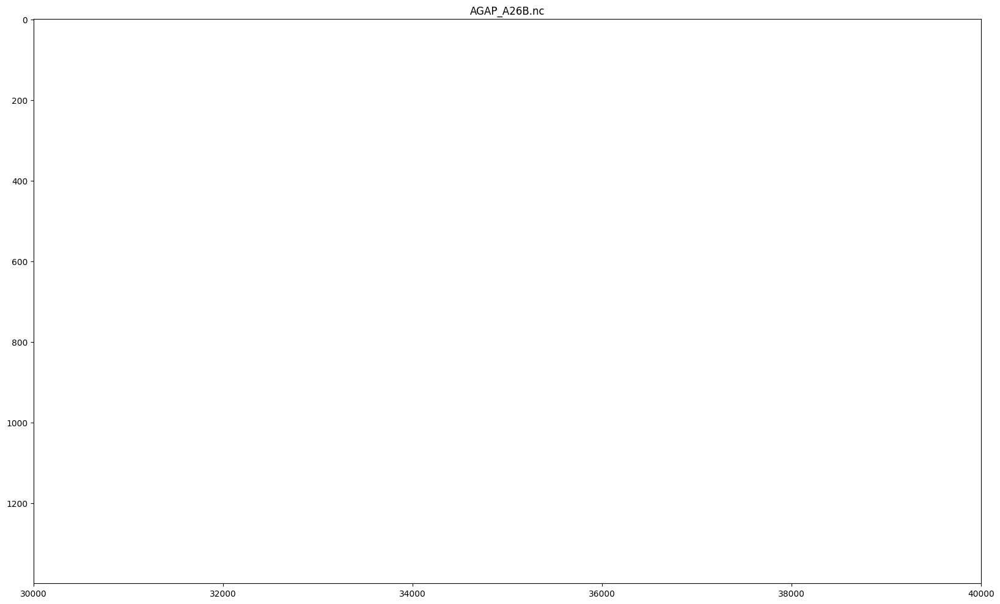

In [42]:
for xlim in [(0, 10000), (10000, 20000), (20000, 30000), (30000, 40000)]:
    plot_picked_chirp_radargram('AGAP_A26B.nc', xlim=xlim, highlighted_traces=None)

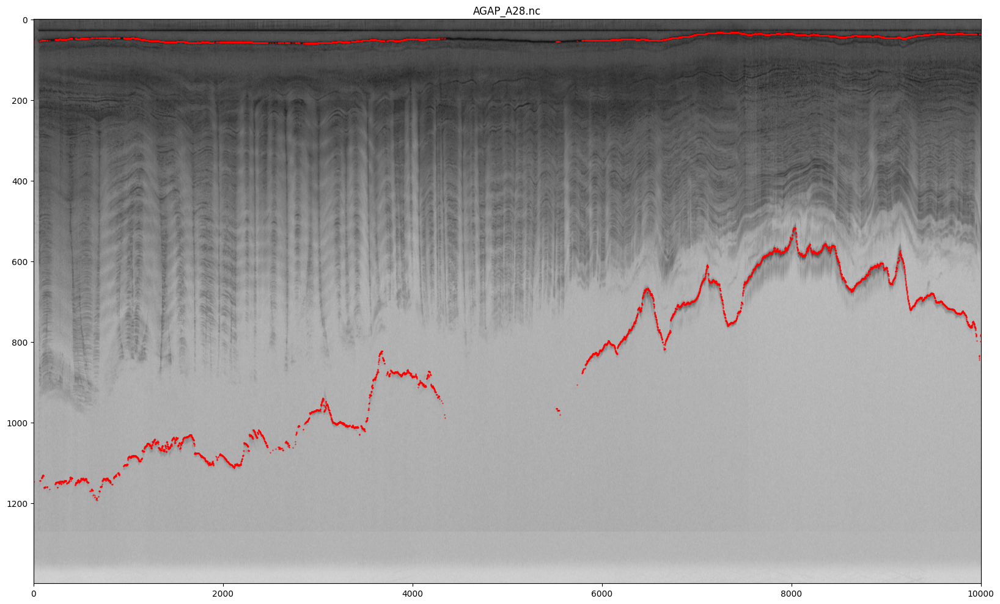

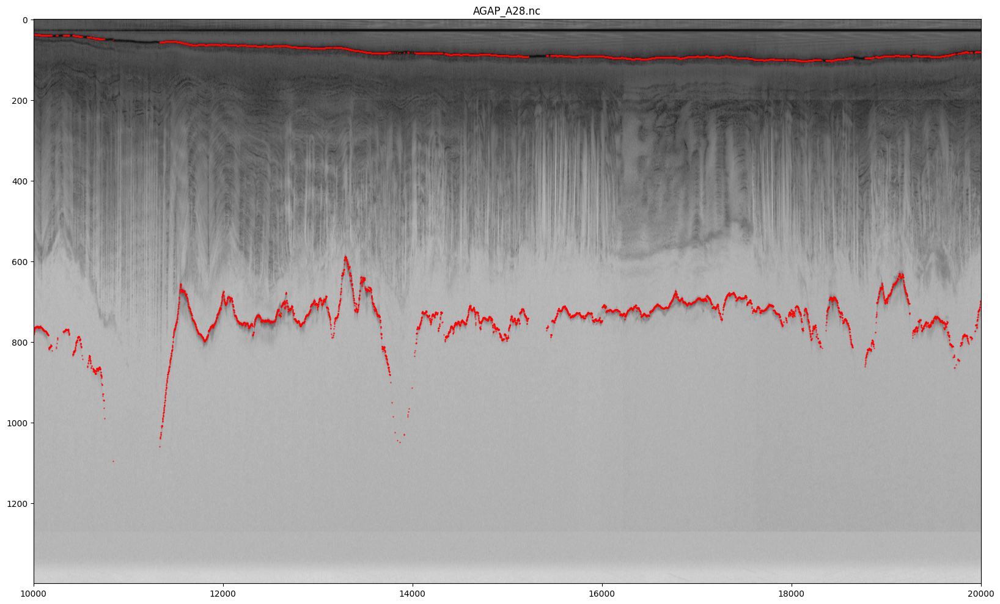

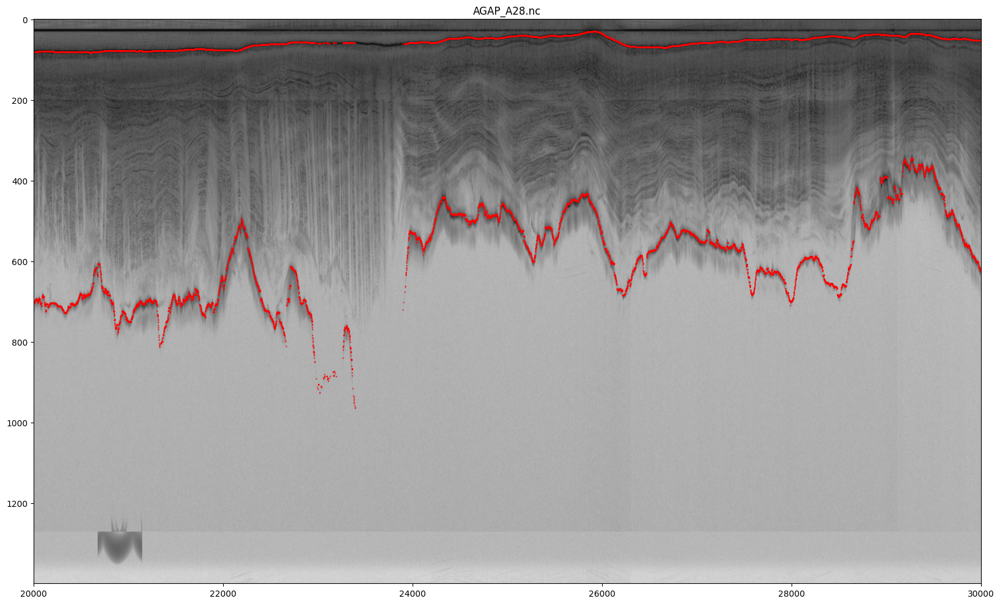

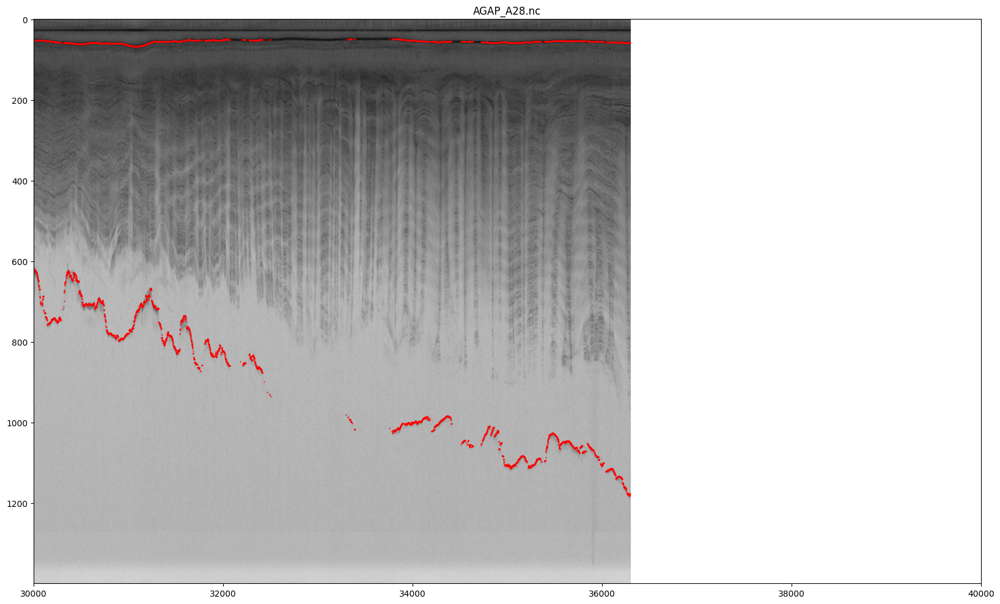

In [43]:
for xlim in [(0, 10000), (10000, 20000), (20000, 30000), (30000, 40000)]:
    plot_picked_chirp_radargram('AGAP_A28.nc', xlim=xlim, highlighted_traces=None)

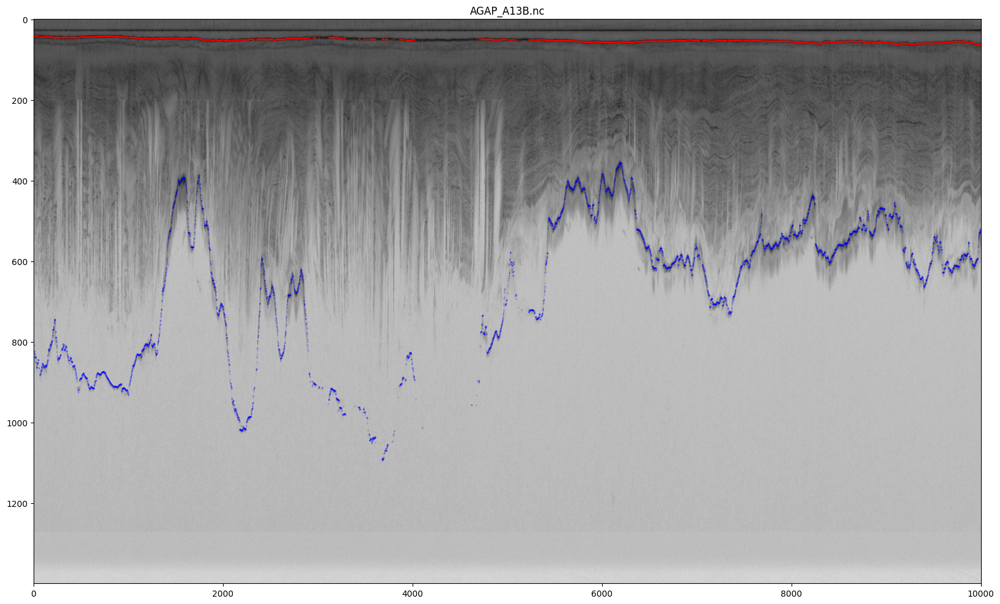

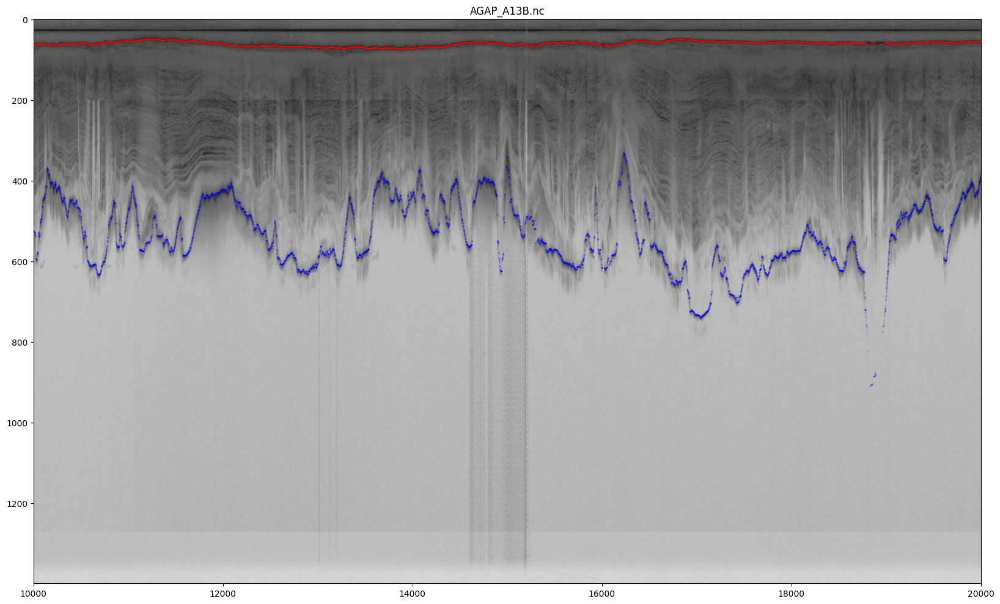

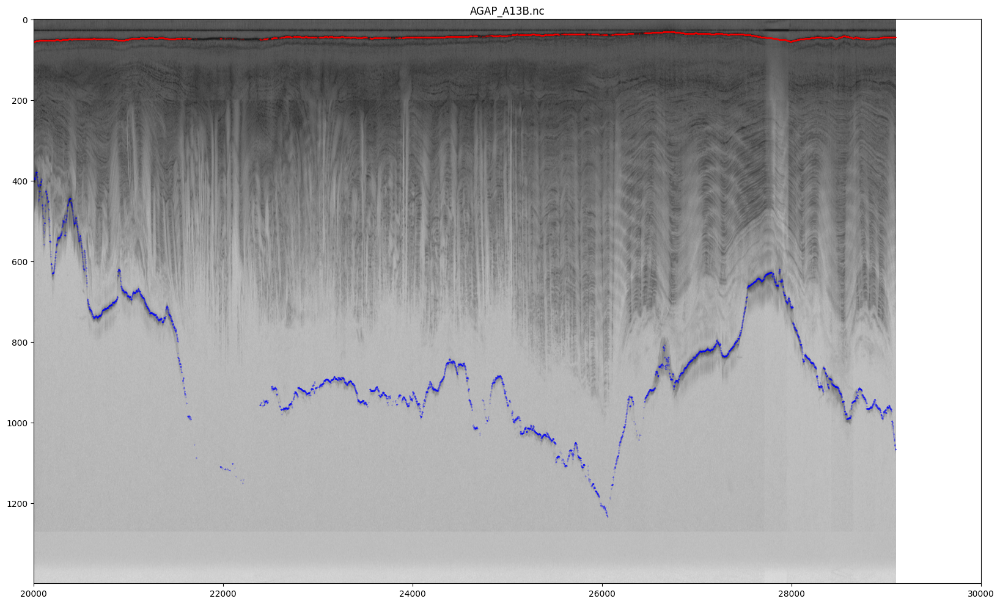

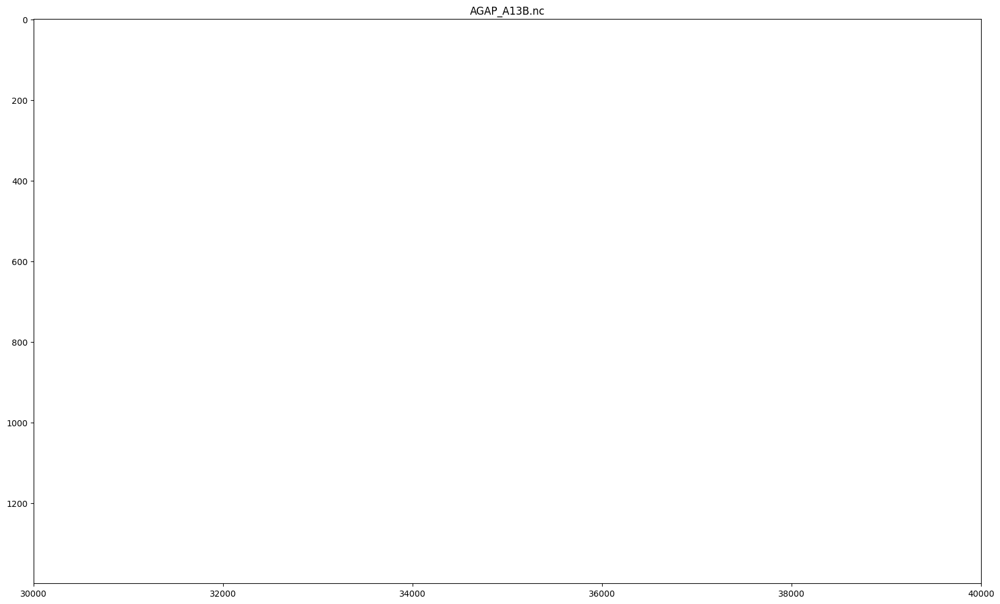

In [35]:
for xlim in [(0, 10000), (10000, 20000), (20000, 30000), (30000, 40000)]:
    plot_picked_chirp_radargram('AGAP_A13B.nc', xlim=xlim, highlighted_traces=None)

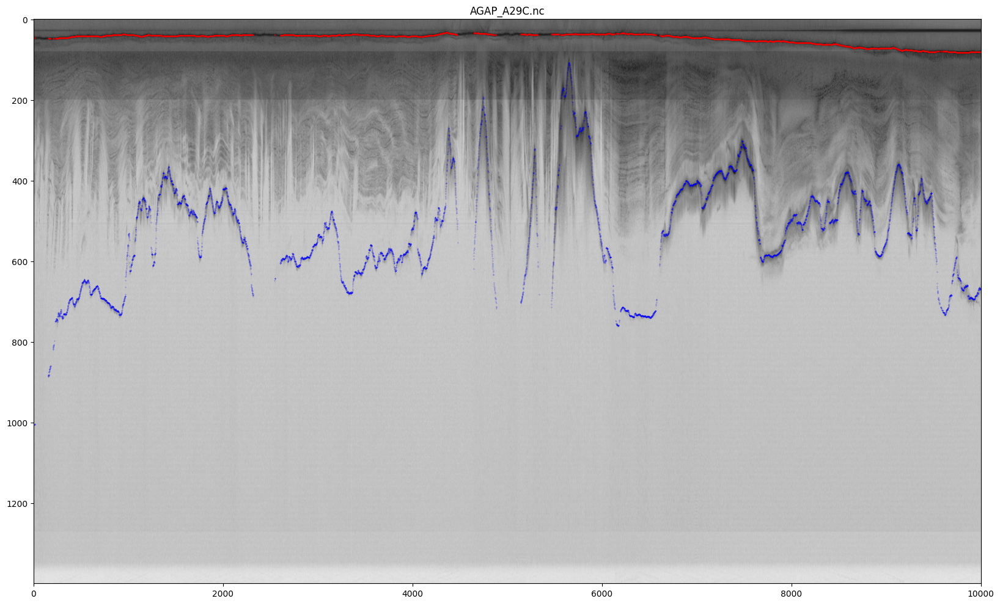

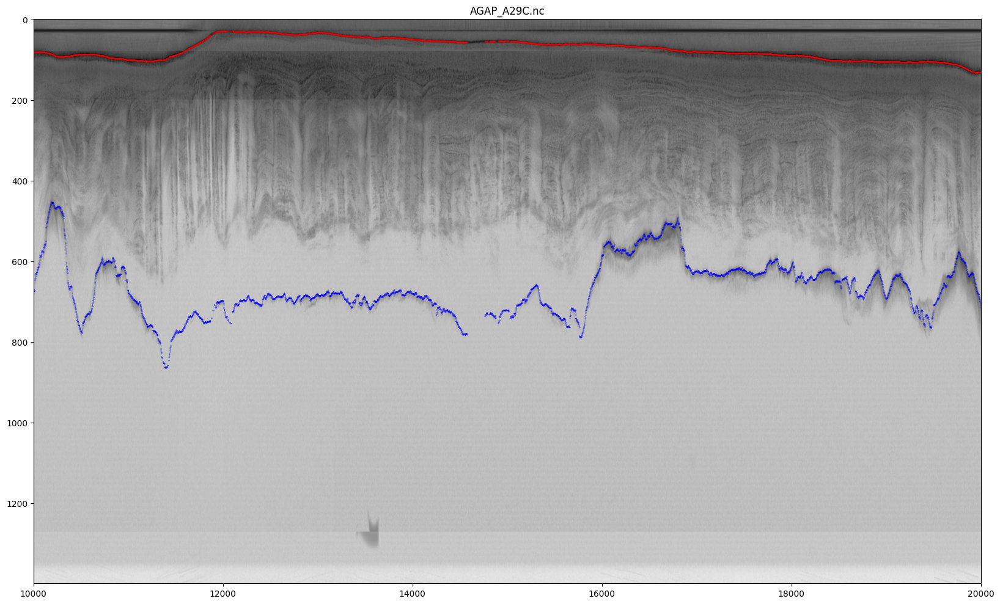

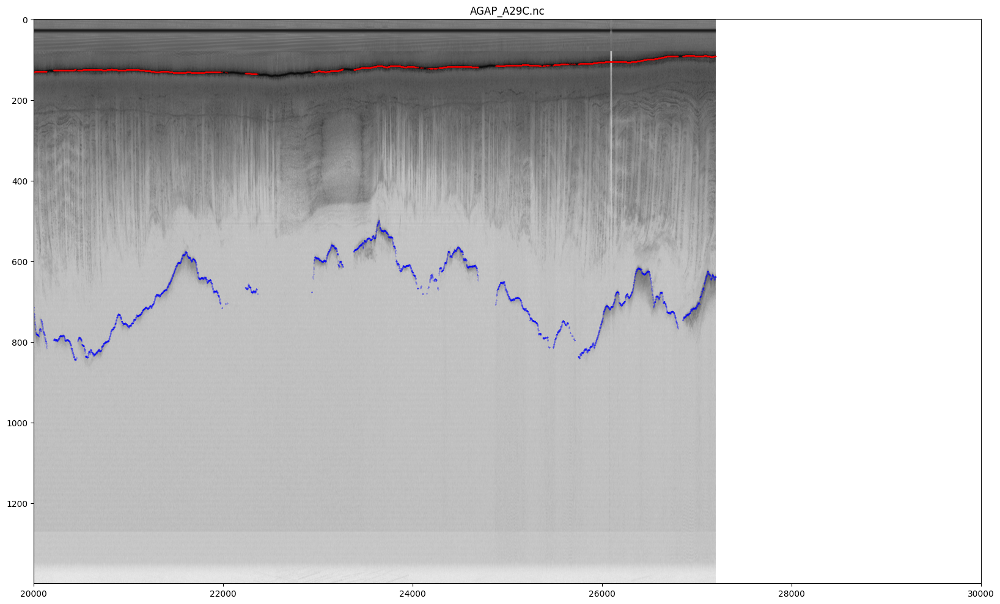

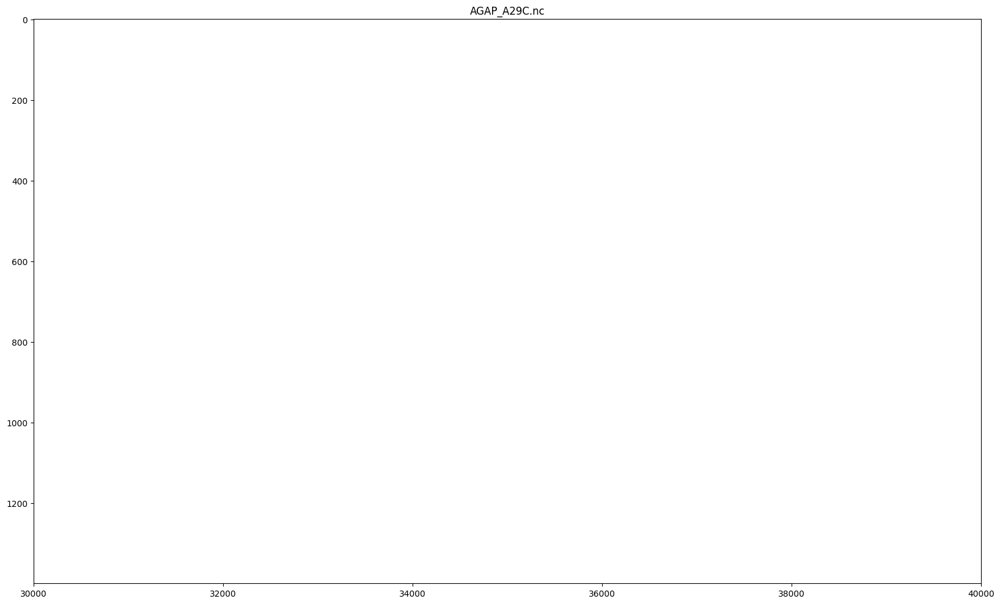

In [36]:
for xlim in [(0, 10000), (10000, 20000), (20000, 30000), (30000, 40000)]:
    plot_picked_chirp_radargram('AGAP_A29C.nc', xlim=xlim, highlighted_traces=None)

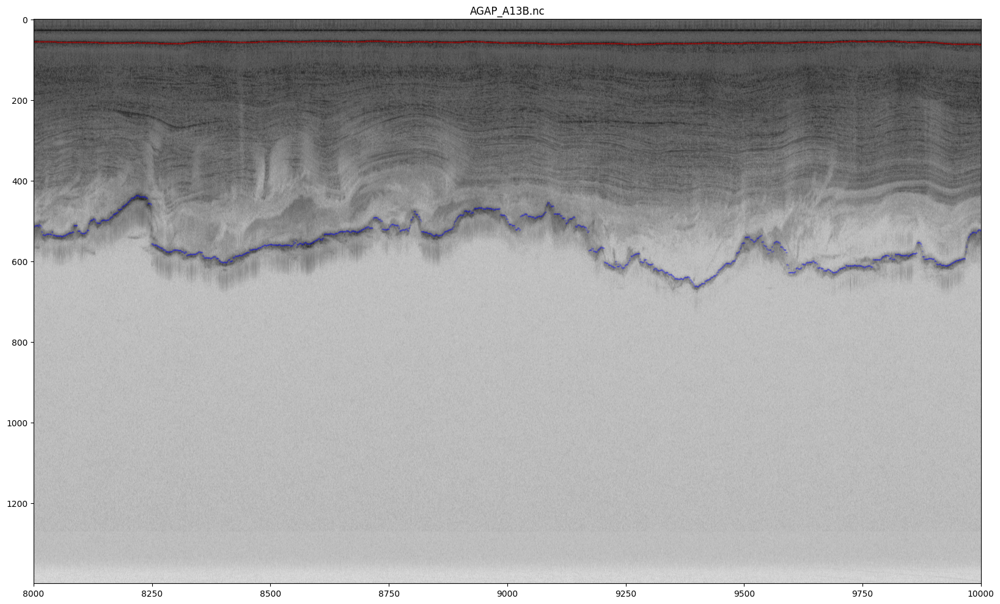

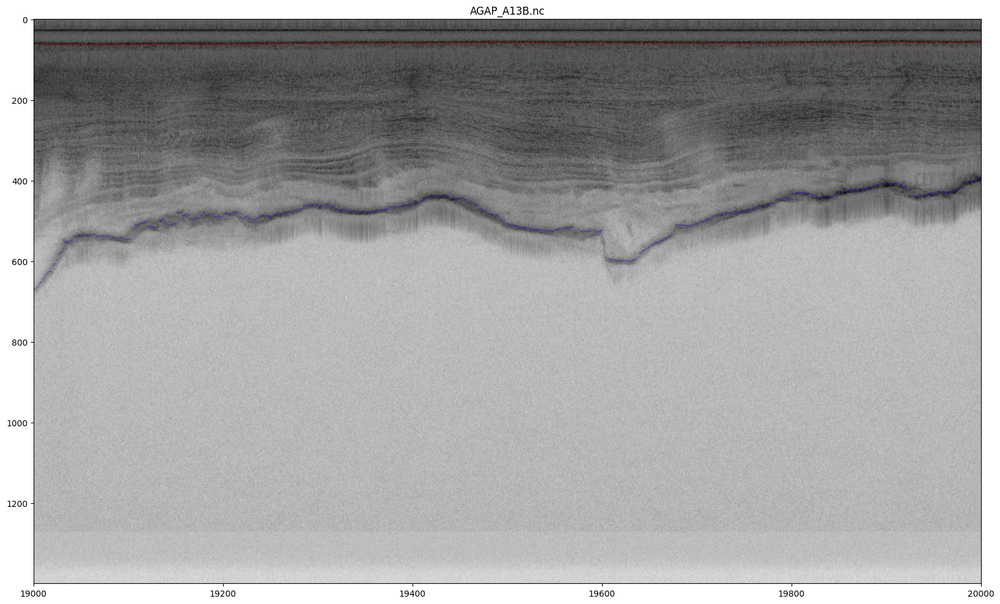

In [37]:
plot_picked_chirp_radargram('AGAP_A13B.nc', xlim=(8000,10000), highlighted_traces=None)
plot_picked_chirp_radargram('AGAP_A13B.nc', xlim=(19000,20000), highlighted_traces=None)

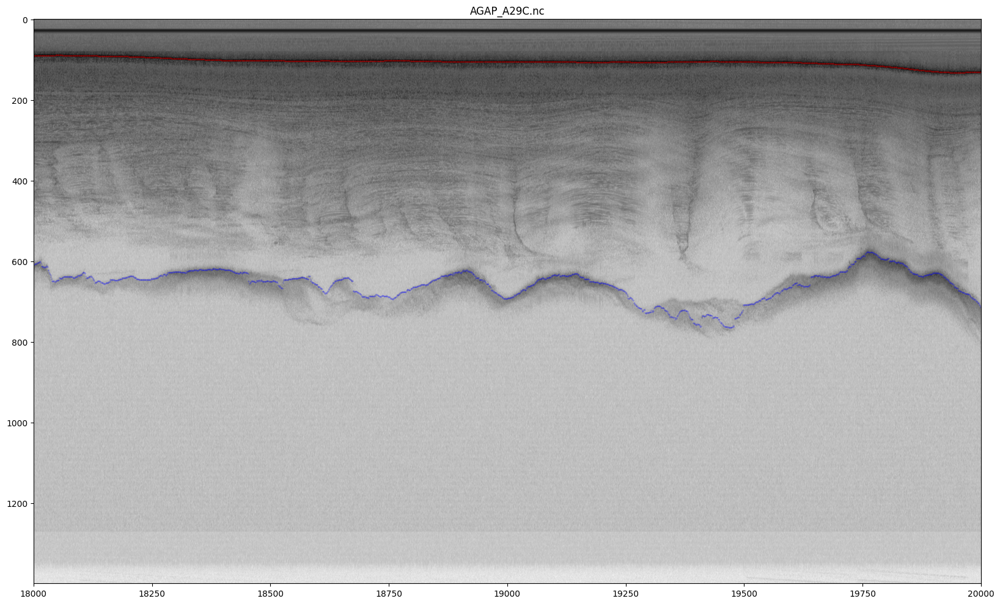

In [38]:
plot_picked_chirp_radargram('AGAP_A29C.nc', xlim=(18000,20000), highlighted_traces=None)

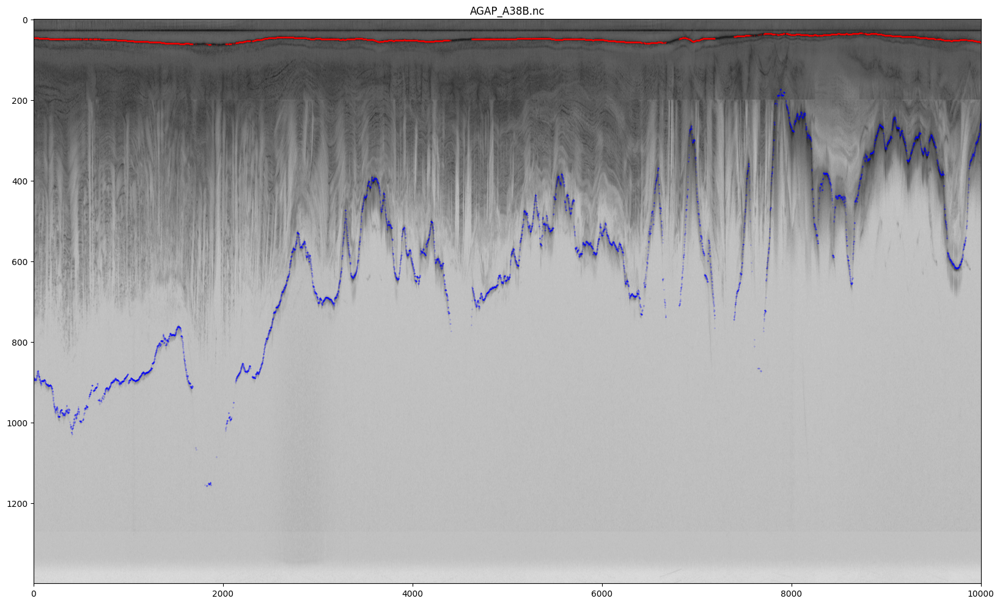

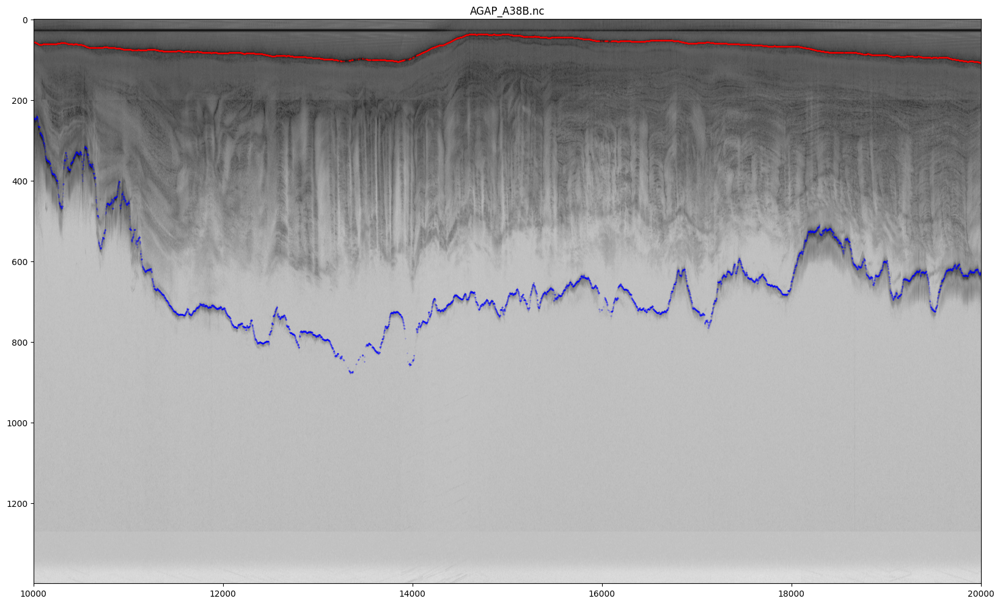

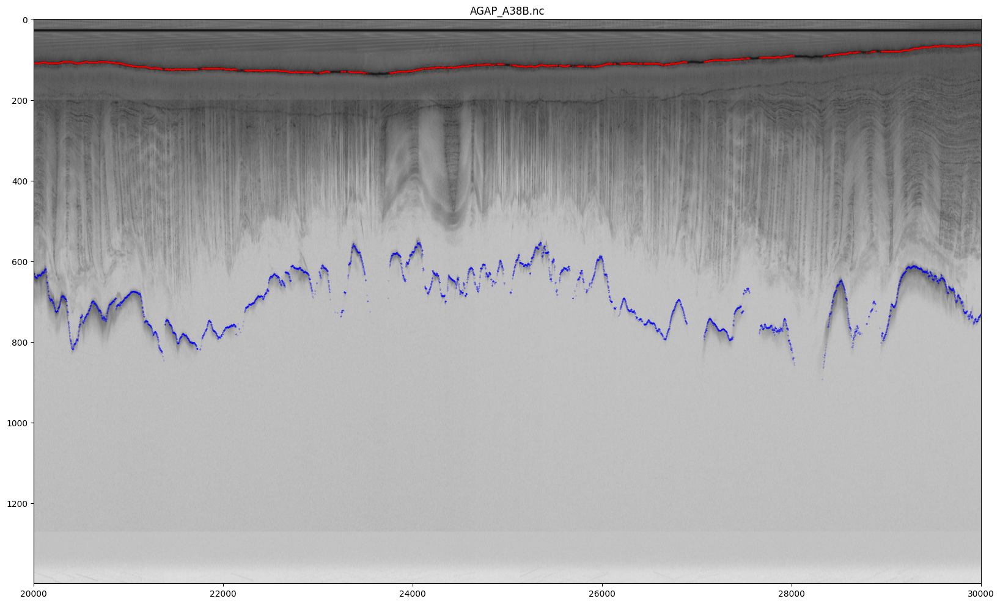

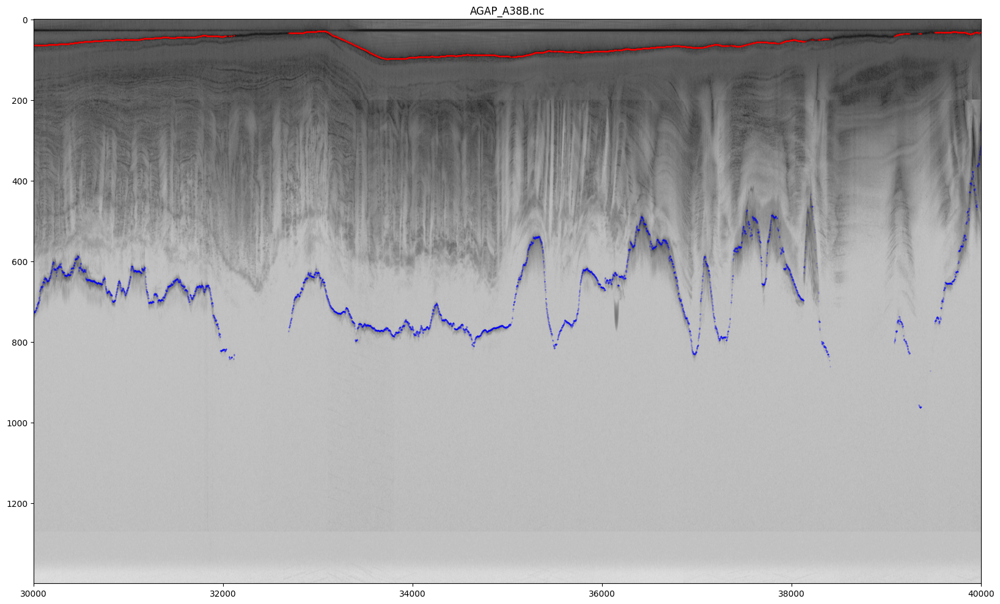

In [39]:
for xlim in [(0, 10000), (10000, 20000), (20000, 30000), (30000, 40000)]:
    plot_picked_chirp_radargram('AGAP_A38B.nc', xlim=xlim, highlighted_traces=None)

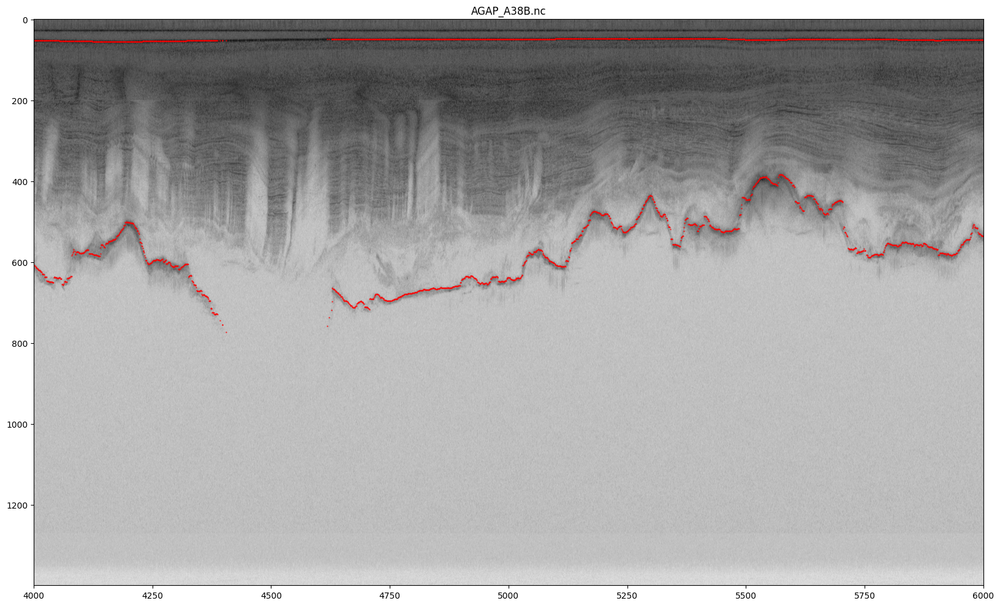

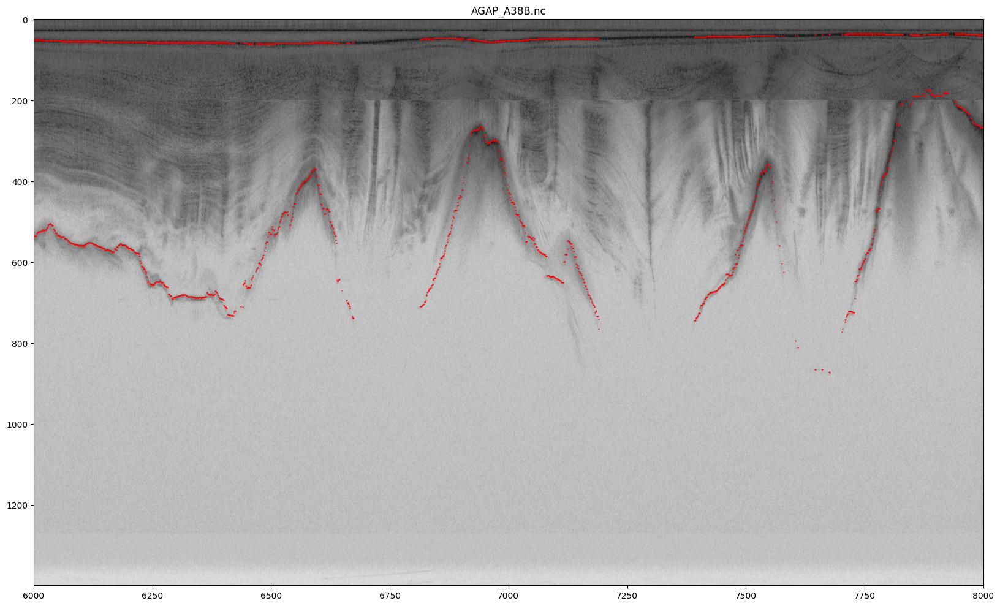

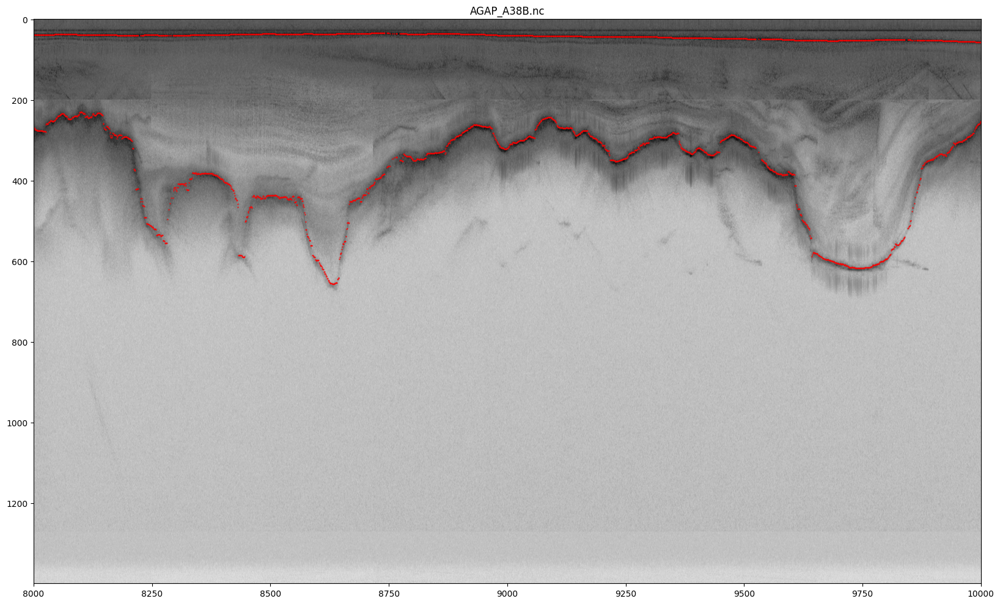

In [46]:
for xlim in [(4000,6000), (6000,8000), (8000,10000)]:
    plot_picked_chirp_radargram('AGAP_A38B.nc', xlim=xlim, highlighted_traces=None)